In [177]:
%matplotlib inline
import matplotlib as mlp
mlp.rcParams['figure.dpi'] = 200

# diasbling warning messages
import warnings
warnings.filterwarnings("ignore")

# importing key libraries
import pandas as pd
pd.set_option('display.max_rows', None)
pd.options.display.float_format = '{:.2f}'.format

# numpy import
import numpy as np

# scipy import
import scipy.stats as stats
from math import sqrt

import datetime

# importing acquire module
import acquire
from acquire import get_zillow_dataset, \
                    null_df, \
                    drop_nulls, \
                    clean_zillow_dataset, \
                    train_validate_test_split

# importing data visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns 
sns.set()

# sklearn data science library
from sklearn.impute import KNNImputer
from sklearn.impute import MissingIndicator
from sklearn.experimental import enable_iterative_imputer
from sklearn.metrics import mean_squared_error
from sklearn.impute import IterativeImputer
from sklearn.cluster import KMeans

from sklearn.preprocessing import RobustScaler, StandardScaler, MinMaxScaler
from sklearn.linear_model import LinearRegression, LassoLars, TweedieRegressor
from sklearn.feature_selection import SelectKBest, RFE, f_regression

In [178]:
# data acquisition and preparation

df = get_zillow_dataset()
print(df.shape)

(52319, 68)


In [179]:
# initial clean of dataset 
# where: feature and record null % > 80% are dropped

df = clean_zillow_dataset(df)
df.head()

dataframe shape: (52238, 14)


,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,transaction_date,year_built
0,14297519,1023282.00,0.03,3.50,4.00,3100.00,Orange County,33634931.00,-117869207.00,4506.00,122,60590630.072012,2017-01-01,1998.00
1,17052889,464000.00,0.06,1.00,2.00,1465.00,Ventura County,34449266.00,-119281531.00,12647.00,1110,61110010.02300601,2017-01-01,1967.00
2,14186244,564778.00,0.01,2.00,3.00,1243.00,Orange County,33886168.00,-117823170.00,8432.00,122,60590218.022012,2017-01-01,1962.00
3,12177905,145143.00,-0.10,3.00,4.00,2376.00,LA County,34245180.00,-118240722.00,13038.00,0101,60373001.00100601,2017-01-01,1970.00
4,12095076,773303.00,-0.00,3.00,4.00,2962.00,LA County,34145202.00,-118179824.00,63000.00,0101,60374608.001014,2017-01-01,1950.00


In [180]:
# calculating and adding age of the home thru 2017

df = acquire.age_of_homes(df)
df.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,transaction_date,year_built,home_age
0,14297519,1023282.00,0.03,3.50,4.00,3100.00,Orange County,33634931.00,-117869207.00,4506.00,122,60590630.072012,2017-01-01,1998.00,19.00
1,17052889,464000.00,0.06,1.00,2.00,1465.00,Ventura County,34449266.00,-119281531.00,12647.00,1110,61110010.02300601,2017-01-01,1967.00,50.00
2,14186244,564778.00,0.01,2.00,3.00,1243.00,Orange County,33886168.00,-117823170.00,8432.00,122,60590218.022012,2017-01-01,1962.00,55.00
3,12177905,145143.00,-0.10,3.00,4.00,2376.00,LA County,34245180.00,-118240722.00,13038.00,0101,60373001.00100601,2017-01-01,1970.00,47.00
4,12095076,773303.00,-0.00,3.00,4.00,2962.00,LA County,34145202.00,-118179824.00,63000.00,0101,60374608.001014,2017-01-01,1950.00,67.00


In [181]:
# adding transactions by month columns

df = acquire.clean_months(df)
df.head()

,parcel_id,home_value,logerror,bathroom_count,bedroom_count,living_sq_feet,county_by_fips,latitude,longitude,property_sq_feet,county_zoning_code,blockgroup_assignment,year_built,home_age,transaction_month
0,14297519,1023282.00,0.03,3.50,4.00,3100.00,Orange County,33634931.00,-117869207.00,4506.00,122,60590630.072012,1998.00,19.00,January
1,17052889,464000.00,0.06,1.00,2.00,1465.00,Ventura County,34449266.00,-119281531.00,12647.00,1110,61110010.02300601,1967.00,50.00,January
2,14186244,564778.00,0.01,2.00,3.00,1243.00,Orange County,33886168.00,-117823170.00,8432.00,122,60590218.022012,1962.00,55.00,January
3,12177905,145143.00,-0.10,3.00,4.00,2376.00,LA County,34245180.00,-118240722.00,13038.00,0101,60373001.00100601,1970.00,47.00,January
4,12095076,773303.00,-0.00,3.00,4.00,2962.00,LA County,34145202.00,-118179824.00,63000.00,0101,60374608.001014,1950.00,67.00,January


In [182]:
# df['example1'] = pd.to_datetime(df.transaction_date).dt.to_period('m')
# df['example1'].head()

In [183]:
# df['example2'] = pd.to_datetime(df.transaction_date).dt.strftime('%m/%Y')
# df.example2.head()

In [184]:
# dataframe info

sorted_cols = df.columns.sort_values()
df[sorted_cols].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 52238 entries, 0 to 52318
Data columns (total 15 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   bathroom_count         52238 non-null  float64
 1   bedroom_count          52238 non-null  float64
 2   blockgroup_assignment  52238 non-null  object 
 3   county_by_fips         52238 non-null  object 
 4   county_zoning_code     52238 non-null  object 
 5   home_age               52200 non-null  float64
 6   home_value             52237 non-null  float64
 7   latitude               52238 non-null  float64
 8   living_sq_feet         52238 non-null  float64
 9   logerror               52238 non-null  float64
 10  longitude              52238 non-null  float64
 11  parcel_id              52238 non-null  object 
 12  property_sq_feet       51881 non-null  float64
 13  transaction_month      52238 non-null  object 
 14  year_built             52200 non-null  float64
dtypes:

In [185]:
# checking initial dataset nulls and percentage of dataframe features

remaining_nulls = null_df(df)
remaining_nulls

,Total Null,Feature Null %
property_sq_feet,357,0.01
year_built,38,0.00
home_age,38,0.00
home_value,1,0.00
parcel_id,0,0.00
logerror,0,0.00
bathroom_count,0,0.00
bedroom_count,0,0.00
living_sq_feet,0,0.00
county_by_fips,0,0.00


In [186]:
# summing total number of outliers per continuous feature - target variable

acquire.sum_outliers(df)

,Feature,Upper_Bound,Total Outliers
0,property_sq_feet,13591.00,5528
1,home_value,1256382.50,3507
2,living_sq_feet,3863.00,2272
3,bathroom_count,4.50,1577
4,bedroom_count,5.50,777
5,home_age,110.50,240
6,latitude,34727747.88,34


In [187]:
# identifying continuous variables/features:

num_lst = df.select_dtypes("number").columns.tolist()
num_lst = [ele for ele in num_lst if ele not in ("logerror_capped", "parcel_id", "year_built_capped")]
num_lst

['home_value',
 'logerror',
 'bathroom_count',
 'bedroom_count',
 'living_sq_feet',
 'latitude',
 'longitude',
 'property_sq_feet',
 'year_built',
 'home_age']

In [188]:
# check the df shape before handling outliers

df.shape

(52238, 15)

In [189]:
# let's handle the outliers using a upper bound "capping" method

df = acquire.capp_outliers(df)
df.head()

,parcel_id,home_value_capped,logerror_capped,bathroom_count_capped,bedroom_count_capped,living_sq_feet_capped,county_by_fips,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,home_age_capped,transaction_month
0,14297519,1023282.00,0.03,3.50,4.00,3100.00,Orange County,33634931.00,-117869207.00,4506.00,122,60590630.072012,1998.00,19.00,January
1,17052889,464000.00,0.06,1.00,2.00,1465.00,Ventura County,34449266.00,-119281531.00,12647.00,1110,61110010.02300601,1967.00,50.00,January
2,14186244,564778.00,0.01,2.00,3.00,1243.00,Orange County,33886168.00,-117823170.00,8432.00,122,60590218.022012,1962.00,55.00,January
3,12177905,145143.00,-0.10,3.00,4.00,2376.00,LA County,34245180.00,-118240722.00,13038.00,0101,60373001.00100601,1970.00,47.00,January
4,12095076,773303.00,-0.00,3.00,4.00,2962.00,LA County,34145202.00,-118179824.00,13591.00,0101,60374608.001014,1950.00,67.00,January


In [190]:
# checking the dataframe shape after capping outliers

df.shape

(52238, 15)

----
### **``splitting zillow dataset and cleaning remaining nulls/missing values:``**

In [191]:
# splitting the dataset to 1. fill-in remaining nulls and 2. determine outlier cutoffs

train, validate, test = train_validate_test_split(df)

train shape: (29253, 15)
validate shape: (12537, 15)
test shape: (10448, 15)


In [192]:
# creating a new continuous feature list in datasets

num_lst = train.select_dtypes("number").columns.tolist()
num_lst = [ele for ele in num_lst if ele not in ("logerror_capped", "home_value")]
num_lst

['home_value_capped',
 'bathroom_count_capped',
 'bedroom_count_capped',
 'living_sq_feet_capped',
 'latitude',
 'longitude',
 'property_sq_feet_capped',
 'year_built_capped',
 'home_age_capped']

In [193]:
# checking train dataset for remaining nulls

null_df = null_df(train)
null_df

,Total Null,Feature Null %
property_sq_feet_capped,208,0.01
year_built_capped,21,0.00
home_age_capped,21,0.00
home_value_capped,1,0.00
parcel_id,0,0.00
logerror_capped,0,0.00
bathroom_count_capped,0,0.00
bedroom_count_capped,0,0.00
living_sq_feet_capped,0,0.00
county_by_fips,0,0.00


In [194]:
# checking dataframe after split

train.head()

,parcel_id,home_value_capped,logerror_capped,bathroom_count_capped,bedroom_count_capped,living_sq_feet_capped,county_by_fips,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,home_age_capped,transaction_month
7961,12167890,912304.00,0.14,3.00,3.00,1903.00,LA County,34204513.00,-118131241.00,10704.00,0100,60374602.00100601,1957.00,60.00,February
47936,10933324,1256382.50,0.01,3.00,4.00,2108.00,LA County,34147955.00,-118350425.00,8432.00,0100,60371431.00101,1935.00,82.00,August
20730,10917682,850525.00,-0.04,4.00,4.00,2446.00,LA County,34135818.00,-118407312.00,9568.00,0100,60371439.011,1962.00,55.00,April
1988,11437314,510000.00,-0.05,1.00,3.00,1120.00,LA County,33893976.00,-118334891.00,5250.00,0101,60376037.023002,1953.00,64.00,January
45959,12738926,343172.00,0.03,2.00,3.00,1918.00,LA County,33910440.00,-118013069.00,7936.00,0100,60375040.012003005,1958.00,59.00,August


In [195]:
# using sklearn's iterative imputer to fill-in remaining nulls

def train_iterative_imputer(train_df):

        # placeholder for continuous features
        num_lst = [
        'home_value_capped',
        'bathroom_count_capped',
        'bedroom_count_capped',
        'living_sq_feet_capped',
        'latitude',
        'longitude',
        'property_sq_feet_capped',
        'blockgroup_assignment',
        'year_built_capped',
        'home_age_capped']

        # creating the "thing"
        imputer = IterativeImputer(
                missing_values = np.nan, \
                skip_complete = True, \
                random_state = 123)
        
        # fitting the "thing" and transforming it
        imputed = imputer.fit_transform(train_df[num_lst])

           # create a new dataframe with learned imputed data
        train_df_imputed = pd.DataFrame(imputed, index = train_df.index)

        # filling in missing values from learned imputer
        train_df[num_lst] = train_df_imputed

        # return the new imputed df
        return train_df

In [196]:
# let's fit the imputer and return it

train_imputed = train_iterative_imputer(train)
train_imputed.isnull().sum()

parcel_id                  0
home_value_capped          0
logerror_capped            0
bathroom_count_capped      0
bedroom_count_capped       0
living_sq_feet_capped      0
county_by_fips             0
latitude                   0
longitude                  0
property_sq_feet_capped    0
county_zoning_code         0
blockgroup_assignment      0
year_built_capped          0
home_age_capped            0
transaction_month          0
dtype: int64

In [197]:
# let's transform validate and test datasets

num_lst = [
        'bathroom_count_capped',
        'bedroom_count_capped',
        'living_sq_feet_capped',
        'latitude',
        'longitude',
        'property_sq_feet_capped',
        'blockgroup_assignment',
        'year_built_capped',
        'home_age_capped']

# creating the "thing"
imputer = IterativeImputer(
        missing_values = np.nan, \
        skip_complete = True, \
        random_state = 123)

# fitting the "thing" and transforming it
imputed = imputer.fit(train[num_lst])

val_imputed = imputed.transform(validate[num_lst])
X_validate_imputed = pd.DataFrame(val_imputed, index = validate.index)
validate[num_lst] = X_validate_imputed
validate_imputed = validate

test_imputed = imputed.transform(test[num_lst])
test_imputed = pd.DataFrame(test_imputed, index = test.index)
test[num_lst] = test_imputed
test_imputed = test

# checking the dataset for nulls
print('null results in: validate')
print('----------------------------|---------')
print(f'{validate_imputed.isnull().sum()}')
print()
print('null results in: test')
print('----------------------------|---------')
print(f'{test_imputed.isnull().sum()}')

null results in: validate
----------------------------|---------
parcel_id                  0
home_value_capped          0
logerror_capped            0
bathroom_count_capped      0
bedroom_count_capped       0
living_sq_feet_capped      0
county_by_fips             0
latitude                   0
longitude                  0
property_sq_feet_capped    0
county_zoning_code         0
blockgroup_assignment      0
year_built_capped          0
home_age_capped            0
transaction_month          0
dtype: int64

null results in: test
----------------------------|---------
parcel_id                  0
home_value_capped          0
logerror_capped            0
bathroom_count_capped      0
bedroom_count_capped       0
living_sq_feet_capped      0
county_by_fips             0
latitude                   0
longitude                  0
property_sq_feet_capped    0
county_zoning_code         0
blockgroup_assignment      0
year_built_capped          0
home_age_capped            0
transaction_month  

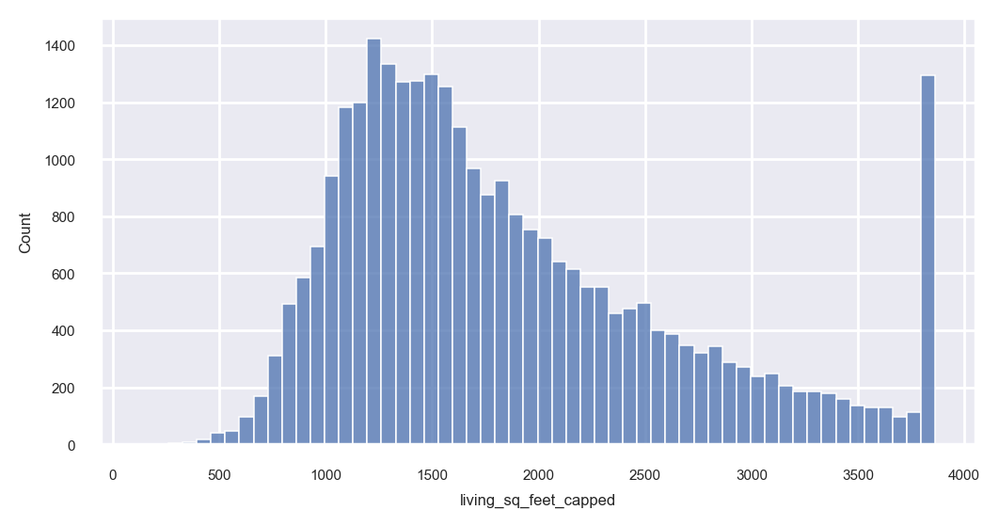

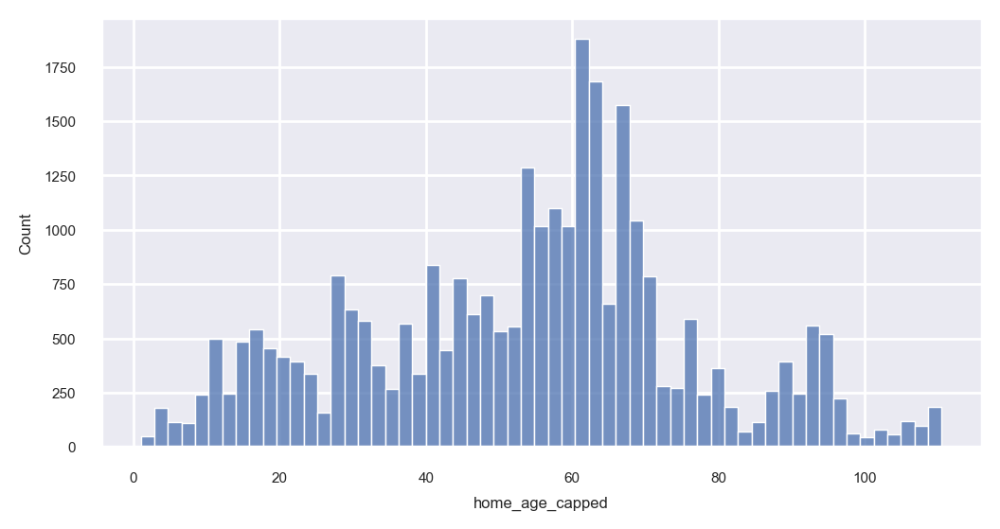

In [198]:
# let's bin the following features:

# living sq. feet = relative size of the home (<1K, 1-2K, 2-3K, 4K, etc.)
# home age = relative age of the home (e.g., recent build, mid-century, early-century, last-century, etc.)

for col in train_imputed[["living_sq_feet_capped", "home_age_capped"]]:
    plt.figure(figsize = (6, 3))
    sns.set(font_scale = .5)
    
    sns.histplot(train_imputed[col])
    plt.show()


In [199]:
pd.qcut(
    train_imputed["home_age_capped"],
    q = 4).unique()

[(57.0, 67.0], (67.0, 110.5], (38.0, 57.0], (0.999, 38.0]]
Categories (4, interval[float64, right]): [(0.999, 38.0] < (38.0, 57.0] < (57.0, 67.0] < (67.0, 110.5]]

In [200]:
# pandas cut method on Home Age
# [(0.999, 38.0] > (38.0, 57.0] > (57.0, 67.0], (67.0, 110.5]]

age_labels = ["new_century", "late_20th_century", "mid_20th_century", "early_20th_century"]

train_imputed["home_age_binned"] = pd.qcut(
    train_imputed["home_age_capped"],
    q = 4,
    labels = age_labels)

validate_imputed["home_age_binned"] = pd.qcut(
    validate_imputed["home_age_capped"], 
    q = 4, 
    labels = age_labels)

test_imputed["home_age_binned"] = pd.qcut(
    test_imputed["home_age_capped"], 
    q = 4, 
    labels = age_labels)

train_imputed.head()

,parcel_id,home_value_capped,logerror_capped,bathroom_count_capped,bedroom_count_capped,living_sq_feet_capped,county_by_fips,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,home_age_capped,transaction_month,home_age_binned
7961,12167890,912304.00,0.14,3.00,3.00,1903.00,LA County,34204513.00,-118131241.00,10704.00,0100,60374602.00,1957.00,60.00,February,mid_20th_century
47936,10933324,1256382.50,0.01,3.00,4.00,2108.00,LA County,34147955.00,-118350425.00,8432.00,0100,60371431.00,1935.00,82.00,August,early_20th_century
20730,10917682,850525.00,-0.04,4.00,4.00,2446.00,LA County,34135818.00,-118407312.00,9568.00,0100,60371439.01,1962.00,55.00,April,late_20th_century
1988,11437314,510000.00,-0.05,1.00,3.00,1120.00,LA County,33893976.00,-118334891.00,5250.00,0101,60376037.02,1953.00,64.00,January,mid_20th_century
45959,12738926,343172.00,0.03,2.00,3.00,1918.00,LA County,33910440.00,-118013069.00,7936.00,0100,60375040.01,1958.00,59.00,August,mid_20th_century


In [201]:
# home time period

train_imputed[train_imputed["home_age_binned"] == "new_century"].year_built_capped.max()

# 1979 - 2016
# 1960 - 1978
# 1950 - 1959
# 1906.5 - 1949

2016.0

In [202]:
# checking validate dataset

validate_imputed.head()

,parcel_id,home_value_capped,logerror_capped,bathroom_count_capped,bedroom_count_capped,living_sq_feet_capped,county_by_fips,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,home_age_capped,transaction_month,home_age_binned
8027,11265308,135435.00,-0.00,1.00,3.00,850.00,LA County,34657807.00,-118186676.00,11126.00,0100,60379010.07,1953.00,64.00,February,mid_20th_century
16933,12865728,90157.00,0.01,2.00,4.00,1784.00,LA County,34118092.00,-117709916.00,10082.00,0101,60374018.00,1968.00,49.00,April,late_20th_century
18195,12969132,262202.00,0.01,1.00,2.00,1181.00,LA County,34145949.00,-117979580.00,9636.00,0100,60374310.02,1949.00,68.00,April,early_20th_century
42677,14081811,1256382.50,0.01,3.50,5.00,3294.00,Orange County,33726534.00,-118067975.00,7031.00,122,60590995.15,1977.00,40.00,August,late_20th_century
6115,11449682,496753.00,0.14,2.00,3.00,1156.00,LA County,33878520.00,-118331497.00,5887.00,0100,60376500.04,1952.00,65.00,February,mid_20th_century


In [204]:
# pandas cut method on Living Sq. Feet
# [(127.999, 1267.0] < (1267.0, 1654.0] < (1654.0, 2299.0] < (2299.0, 3863.0]]

sq_ft_labels = ["128_to_1267_sqfeet", "1267_to_1654_sqfeet", "1654_to_2299_sqfeet", "2299_to_3863_sqfeet"]

train_imputed["living_sqfeet_binned"] = pd.qcut(
    train_imputed["living_sq_feet_capped"], \
    q = 4, \
    labels = sq_ft_labels)

validate_imputed["living_sqfeet_binned"] = pd.qcut(
    validate_imputed["living_sq_feet_capped"], \
    q = 4, \
    labels = sq_ft_labels)

test_imputed["living_sqfeet_binned"] = pd.qcut(
    test_imputed["living_sq_feet_capped"], \
    q = 4, \
    labels = sq_ft_labels)

train_imputed.head()

,parcel_id,home_value_capped,logerror_capped,bathroom_count_capped,bedroom_count_capped,living_sq_feet_capped,county_by_fips,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,home_age_capped,transaction_month,home_age_binned,living_sqfeet_binned
7961,12167890,912304.00,0.14,3.00,3.00,1903.00,LA County,34204513.00,-118131241.00,10704.00,0100,60374602.00,1957.00,60.00,February,mid_20th_century,1654_to_2299_sqfeet
47936,10933324,1256382.50,0.01,3.00,4.00,2108.00,LA County,34147955.00,-118350425.00,8432.00,0100,60371431.00,1935.00,82.00,August,early_20th_century,1654_to_2299_sqfeet
20730,10917682,850525.00,-0.04,4.00,4.00,2446.00,LA County,34135818.00,-118407312.00,9568.00,0100,60371439.01,1962.00,55.00,April,late_20th_century,2299_to_3863_sqfeet
1988,11437314,510000.00,-0.05,1.00,3.00,1120.00,LA County,33893976.00,-118334891.00,5250.00,0101,60376037.02,1953.00,64.00,January,mid_20th_century,128_to_1267_sqfeet
45959,12738926,343172.00,0.03,2.00,3.00,1918.00,LA County,33910440.00,-118013069.00,7936.00,0100,60375040.01,1958.00,59.00,August,mid_20th_century,1654_to_2299_sqfeet


In [205]:
# let's create a transaction seasons/yearly quarter column by using transaction months

sorted(train_imputed["transaction_month"].unique())

['April',
 'August',
 'February',
 'January',
 'July',
 'June',
 'March',
 'May',
 'September']

In [206]:
# let's create the quarter columns

# train dataset
train_imputed["q1_transaction"] = (train_imputed["transaction_month"] == "January") | (train_imputed["transaction_month"] == "February") | (train_imputed["transaction_month"] == "March")
train_imputed["q2_transaction"] = (train_imputed["transaction_month"] == "April") | (train_imputed["transaction_month"] == "May") | (train_imputed["transaction_month"] == "June")
train_imputed["q3_transaction"] = (train_imputed["transaction_month"] == "July") | (train_imputed["transaction_month"] == "August") | (train_imputed["transaction_month"] == "September")

# validate dataset
validate_imputed["q1_transaction"] = (validate_imputed["transaction_month"] == "January") | (validate_imputed["transaction_month"] == "February") | (validate_imputed["transaction_month"] == "March")
validate_imputed["q2_transaction"] = (validate_imputed["transaction_month"] == "April") | (validate_imputed["transaction_month"] == "May") | (validate_imputed["transaction_month"] == "June")
validate_imputed["q3_transaction"] = (validate_imputed["transaction_month"] == "July") | (validate_imputed["transaction_month"] == "August") | (validate_imputed["transaction_month"] == "September")

# test dataset
test_imputed["q1_transaction"] = (test_imputed["transaction_month"] == "January") | (test_imputed["transaction_month"] == "February") | (test_imputed["transaction_month"] == "March")
test_imputed["q2_transaction"] = (test_imputed["transaction_month"] == "April") | (test_imputed["transaction_month"] == "May") | (test_imputed["transaction_month"] == "June")
test_imputed["q3_transaction"] = (test_imputed["transaction_month"] == "July") | (test_imputed["transaction_month"] == "August") | (test_imputed["transaction_month"] == "September")


train_imputed.head()

,parcel_id,home_value_capped,logerror_capped,bathroom_count_capped,bedroom_count_capped,living_sq_feet_capped,county_by_fips,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,home_age_capped,transaction_month,home_age_binned,living_sqfeet_binned,q1_transaction,q2_transaction,q3_transaction
7961,12167890,912304.00,0.14,3.00,3.00,1903.00,LA County,34204513.00,-118131241.00,10704.00,0100,60374602.00,1957.00,60.00,February,mid_20th_century,1654_to_2299_sqfeet,True,False,False
47936,10933324,1256382.50,0.01,3.00,4.00,2108.00,LA County,34147955.00,-118350425.00,8432.00,0100,60371431.00,1935.00,82.00,August,early_20th_century,1654_to_2299_sqfeet,False,False,True
20730,10917682,850525.00,-0.04,4.00,4.00,2446.00,LA County,34135818.00,-118407312.00,9568.00,0100,60371439.01,1962.00,55.00,April,late_20th_century,2299_to_3863_sqfeet,False,True,False
1988,11437314,510000.00,-0.05,1.00,3.00,1120.00,LA County,33893976.00,-118334891.00,5250.00,0101,60376037.02,1953.00,64.00,January,mid_20th_century,128_to_1267_sqfeet,True,False,False
45959,12738926,343172.00,0.03,2.00,3.00,1918.00,LA County,33910440.00,-118013069.00,7936.00,0100,60375040.01,1958.00,59.00,August,mid_20th_century,1654_to_2299_sqfeet,False,False,True


In [207]:
# let's look at the dataframe column types

train_imputed.dtypes

parcel_id                    object
home_value_capped           float64
logerror_capped             float64
bathroom_count_capped       float64
bedroom_count_capped        float64
living_sq_feet_capped       float64
county_by_fips               object
latitude                    float64
longitude                   float64
property_sq_feet_capped     float64
county_zoning_code           object
blockgroup_assignment       float64
year_built_capped           float64
home_age_capped             float64
transaction_month            object
home_age_binned            category
living_sqfeet_binned       category
q1_transaction                 bool
q2_transaction                 bool
q3_transaction                 bool
dtype: object

In [208]:
# listing discrete/categorical and continuous features

from pandas.api.types import is_string_dtype
from pandas.api.types import is_numeric_dtype

disc_features = []
num_features = []

for col in list(train_imputed.columns):
    if is_numeric_dtype(train_imputed[col]):
        num_features.append(col)
    
    else: disc_features.append(col)

print(f'discrete feature:\n{disc_features}')
print('-------')
print(f'continuous feature:\n{num_features}')

discrete feature:
['parcel_id', 'county_by_fips', 'county_zoning_code', 'transaction_month', 'home_age_binned', 'living_sqfeet_binned']
-------
continuous feature:
['home_value_capped', 'logerror_capped', 'bathroom_count_capped', 'bedroom_count_capped', 'living_sq_feet_capped', 'latitude', 'longitude', 'property_sq_feet_capped', 'blockgroup_assignment', 'year_built_capped', 'home_age_capped', 'q1_transaction', 'q2_transaction', 'q3_transaction']


-----
### **``hypothesis testing``**

In [209]:
# description of continuous variables

summary_stats = train_imputed.describe().T
summary_stats["range"] = summary_stats["max"] - summary_stats["min"]
summary_stats.sort_index()

,count,mean,std,min,25%,50%,75%,max,range
bathroom_count_capped,29253.00,2.27,0.90,0.50,2.00,2.00,3.00,4.50,4.00
bedroom_count_capped,29253.00,3.30,0.89,1.50,3.00,3.00,4.00,5.50,4.00
blockgroup_assignment,29253.00,60493146.12,208519.07,60371011.10,60374010.01,60376033.01,60590423.15,61110091.00,739079.90
home_age_capped,29253.00,53.67,23.04,1.00,38.00,57.00,67.00,110.50,109.50
home_value_capped,29253.00,452370.92,337959.47,1000.00,191515.00,372401.00,613737.00,1256382.50,1255382.50
latitude,29253.00,34025722.41,273939.35,33340620.00,33830415.00,34028312.00,34188344.00,34812397.00,1471777.00
living_sq_feet_capped,29253.00,1866.62,800.69,128.00,1267.00,1654.00,2299.00,3863.00,3735.00
logerror_capped,29253.00,0.01,0.06,-0.12,-0.02,0.01,0.04,0.14,0.26
longitude,29253.00,-118195672.95,355547.71,-119475416.00,-118401541.00,-118155208.00,-117932621.00,-117557472.00,1917944.00
property_sq_feet_capped,29253.00,7473.55,2995.66,775.00,5600.00,6854.00,8782.00,13591.00,12816.00


In [210]:
# let's explore discrete vs. continuous variables/features

for col in list(train_imputed.columns):
    print(f'Feature: {col}')
    print(f'data type: {train_imputed[col].dtype}')
    print(f'number of unique values: {train_imputed[col].nunique()}')
    print()

Feature: parcel_id
data type: object
number of unique values: 29253

Feature: home_value_capped
data type: float64
number of unique values: 21842

Feature: logerror_capped
data type: float64
number of unique values: 25543

Feature: bathroom_count_capped
data type: float64
number of unique values: 9

Feature: bedroom_count_capped
data type: float64
number of unique values: 6

Feature: living_sq_feet_capped
data type: float64
number of unique values: 3148

Feature: county_by_fips
data type: object
number of unique values: 3

Feature: latitude
data type: float64
number of unique values: 28616

Feature: longitude
data type: float64
number of unique values: 28740

Feature: property_sq_feet_capped
data type: float64
number of unique values: 8172

Feature: county_zoning_code
data type: object
number of unique values: 21

Feature: blockgroup_assignment
data type: float64
number of unique values: 20885

Feature: year_built_capped
data type: float64
number of unique values: 132

Feature: home_ag

In [211]:
# what is block group assignment

train_imputed["blockgroup_assignment"].head()

7961    60374602.00
47936   60371431.00
20730   60371439.01
1988    60376037.02
45959   60375040.01
Name: blockgroup_assignment, dtype: float64

In [212]:
# let's check the df information

train_imputed.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29253 entries, 7961 to 25621
Data columns (total 20 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   parcel_id                29253 non-null  object  
 1   home_value_capped        29253 non-null  float64 
 2   logerror_capped          29253 non-null  float64 
 3   bathroom_count_capped    29253 non-null  float64 
 4   bedroom_count_capped     29253 non-null  float64 
 5   living_sq_feet_capped    29253 non-null  float64 
 6   county_by_fips           29253 non-null  object  
 7   latitude                 29253 non-null  float64 
 8   longitude                29253 non-null  float64 
 9   property_sq_feet_capped  29253 non-null  float64 
 10  county_zoning_code       29253 non-null  object  
 11  blockgroup_assignment    29253 non-null  float64 
 12  year_built_capped        29253 non-null  float64 
 13  home_age_capped          29253 non-null  float64 
 14  tra

In [213]:
# re-running feature lists

disc_features = []
num_features = []

for col in list(train_imputed.columns):
    if is_numeric_dtype(train_imputed[col]):
        num_features.append(col)
    
    else: disc_features.append(col)

print(f'discrete feature:\n{disc_features}')
print('-------')
print(f'continuous feature:\n{num_features}')

discrete feature:
['parcel_id', 'county_by_fips', 'county_zoning_code', 'transaction_month', 'home_age_binned', 'living_sqfeet_binned']
-------
continuous feature:
['home_value_capped', 'logerror_capped', 'bathroom_count_capped', 'bedroom_count_capped', 'living_sq_feet_capped', 'latitude', 'longitude', 'property_sq_feet_capped', 'blockgroup_assignment', 'year_built_capped', 'home_age_capped', 'q1_transaction', 'q2_transaction', 'q3_transaction']


In [214]:
# logerror absolute value

abs(train_imputed["logerror_capped"]).mean()

0.047932247537783336

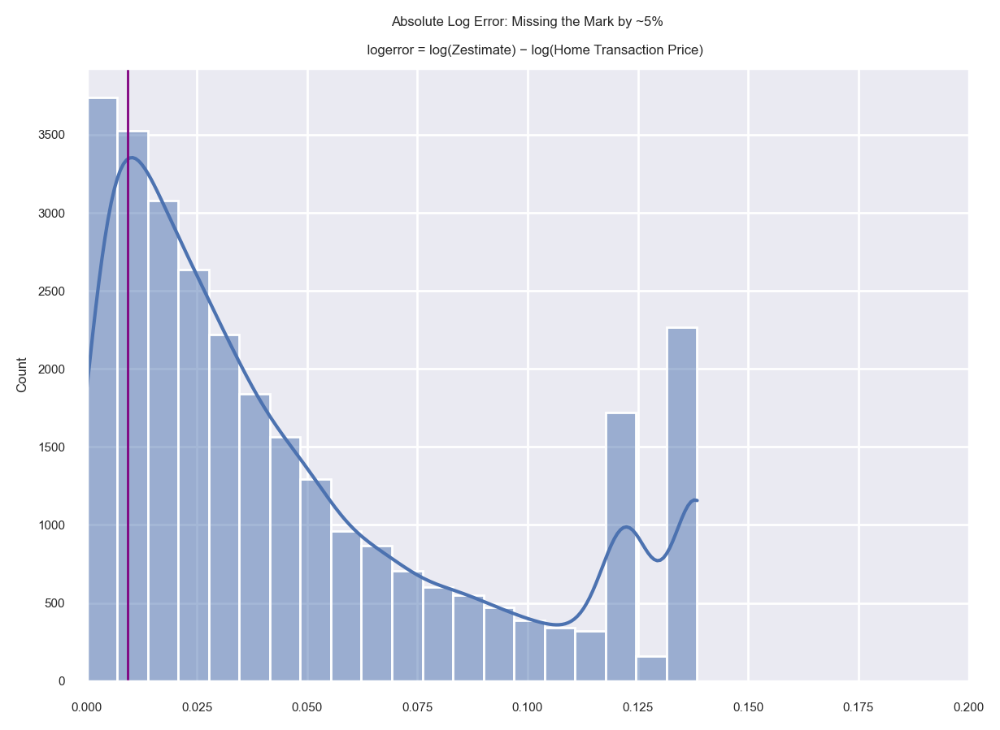

In [215]:
# let's look at absolute value for log error

plt.figure(figsize = (7, 5))
sns.set(font_scale = 0.5)

sns.histplot(
    abs(train_imputed["logerror_capped"]), \
    bins = 20, \
    kde = True)

plt.axvline(abs(train_imputed["logerror_capped"].mean()), 
    linewidth = 1, 
    color = 'purple', 
    label = "mean")
    
# plt.text(0.055, 15500, "7.3% mean logerror", 
#     horizontalalignment = 'left', 
#     size = 'medium', 
#     color = 'purple', 
#     weight = 'semibold')

plt.title('''Absolute Log Error: Missing the Mark by ~5%\n
    logerror = log(Zestimate) − log(Home Transaction Price)''')
plt.xlabel(None)
plt.xlim(0, 0.2)
plt.show()

----
### ``Initial feature relationship plots``

In [216]:
# melting quarter transaction columns

train_imputed["transaction_quarter"] = train_imputed[["q1_transaction", "q2_transaction", "q3_transaction"]].idxmax(1).to_frame('transaction_quarter')
validate_imputed["transaction_quarter"] = validate_imputed[["q1_transaction", "q2_transaction", "q3_transaction"]].idxmax(1).to_frame('transaction_quarter')
test_imputed["transaction_quarter"] = test_imputed[["q1_transaction", "q2_transaction", "q3_transaction"]].idxmax(1).to_frame('transaction_quarter')

# dropping redundant columns

train_imputed.drop(columns = ["q1_transaction", "q2_transaction", "q3_transaction"], inplace = True)
validate_imputed.drop(columns = ["q1_transaction", "q2_transaction", "q3_transaction"], inplace = True)
test_imputed.drop(columns = ["q1_transaction", "q2_transaction", "q3_transaction"], inplace = True)


train.head()

,parcel_id,home_value_capped,logerror_capped,bathroom_count_capped,bedroom_count_capped,living_sq_feet_capped,county_by_fips,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,home_age_capped,transaction_month,home_age_binned,living_sqfeet_binned,transaction_quarter
7961,12167890,912304.00,0.14,3.00,3.00,1903.00,LA County,34204513.00,-118131241.00,10704.00,0100,60374602.00,1957.00,60.00,February,mid_20th_century,1654_to_2299_sqfeet,q1_transaction
47936,10933324,1256382.50,0.01,3.00,4.00,2108.00,LA County,34147955.00,-118350425.00,8432.00,0100,60371431.00,1935.00,82.00,August,early_20th_century,1654_to_2299_sqfeet,q3_transaction
20730,10917682,850525.00,-0.04,4.00,4.00,2446.00,LA County,34135818.00,-118407312.00,9568.00,0100,60371439.01,1962.00,55.00,April,late_20th_century,2299_to_3863_sqfeet,q2_transaction
1988,11437314,510000.00,-0.05,1.00,3.00,1120.00,LA County,33893976.00,-118334891.00,5250.00,0101,60376037.02,1953.00,64.00,January,mid_20th_century,128_to_1267_sqfeet,q1_transaction
45959,12738926,343172.00,0.03,2.00,3.00,1918.00,LA County,33910440.00,-118013069.00,7936.00,0100,60375040.01,1958.00,59.00,August,mid_20th_century,1654_to_2299_sqfeet,q3_transaction


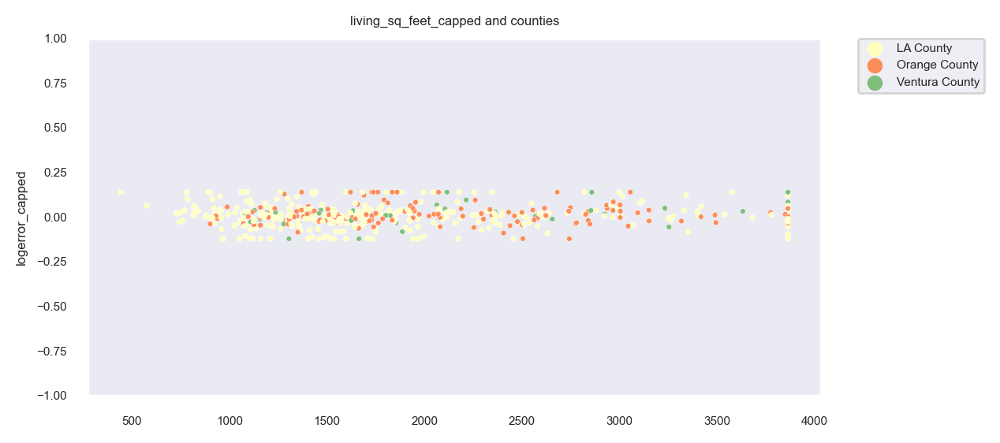

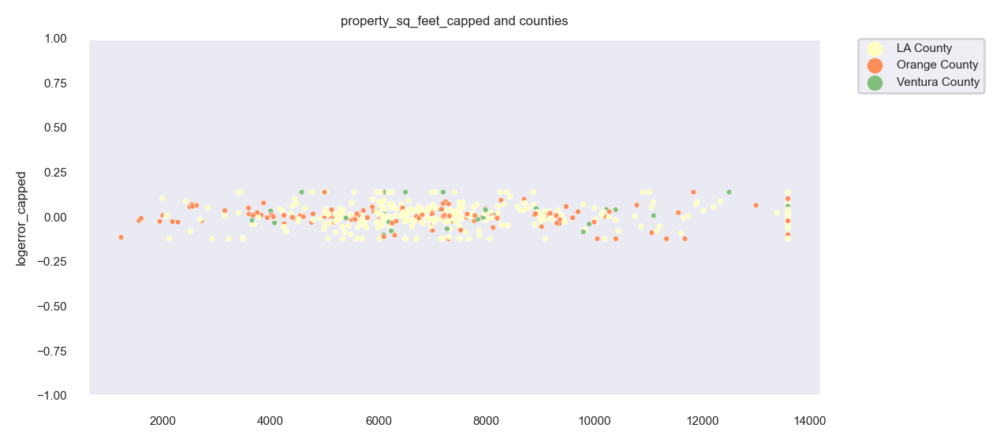

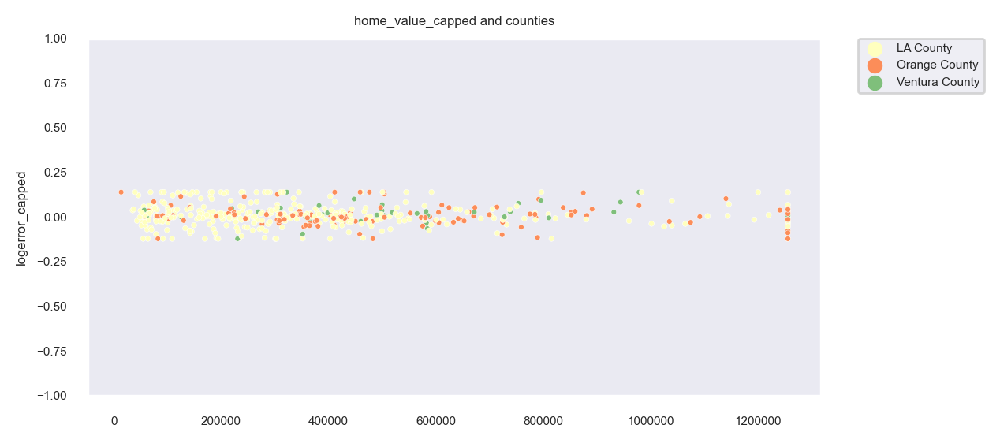

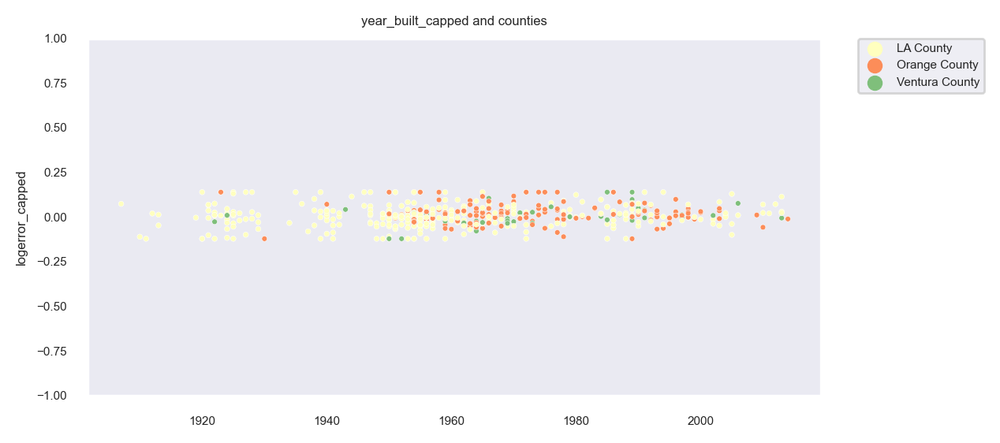

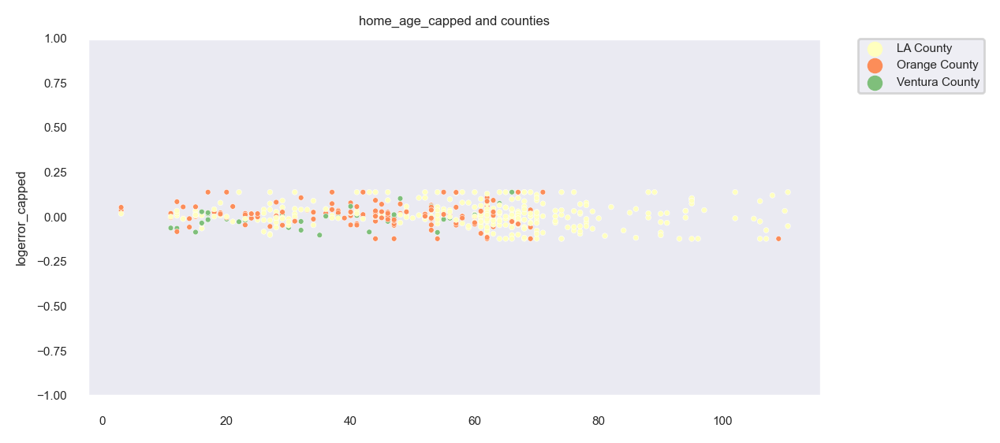

In [217]:
# viewing the log error relationship across continuous features, and counties

num_lst = [
'living_sq_feet_capped',
'property_sq_feet_capped',
'home_value_capped',
'year_built_capped',
'home_age_capped']

for col in num_lst:
    plt.figure(figsize = (6,3))
    sns.set(style = "dark", font_scale = .5)
    ax = sns.scatterplot(x = col,
        y = "logerror_capped",
        data = train_imputed.sample(500),
        hue = "county_by_fips",
        hue_order = ["LA County", "Orange County", "Ventura County"],
        palette = ["#ffffbf", "#fc8d59", "#7fbf7b"],
        sizes = (20,600),
        s = 6)

    # removing scientific notation
    ax.ticklabel_format(style = "plain")
    
    plt.title(f'{col} and counties')
    plt.ylim(-1, 1)
    plt.xlabel(None)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

    plt.show()

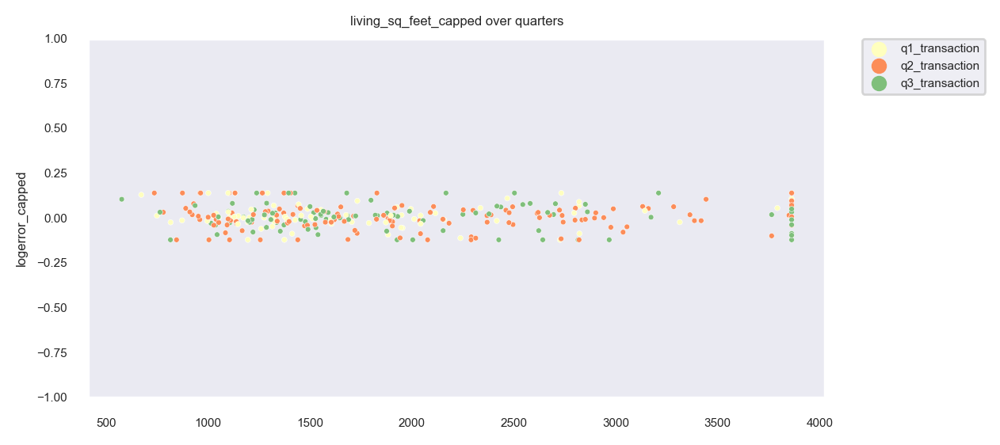

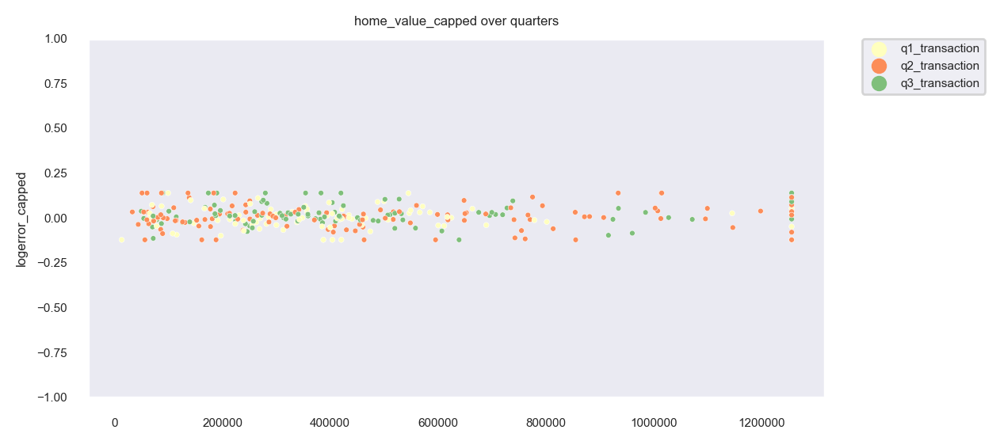

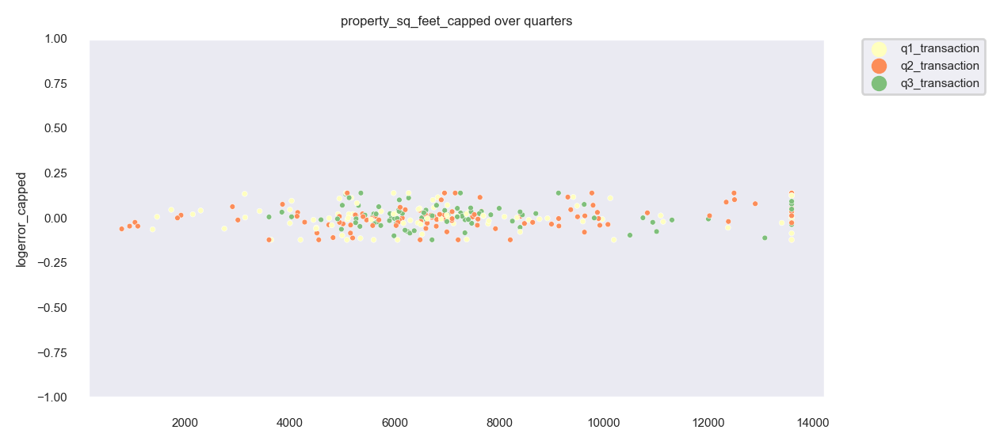

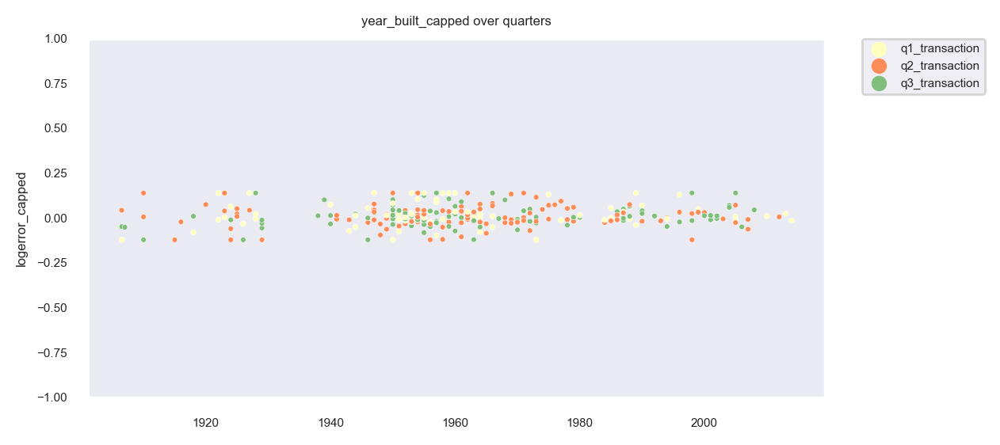

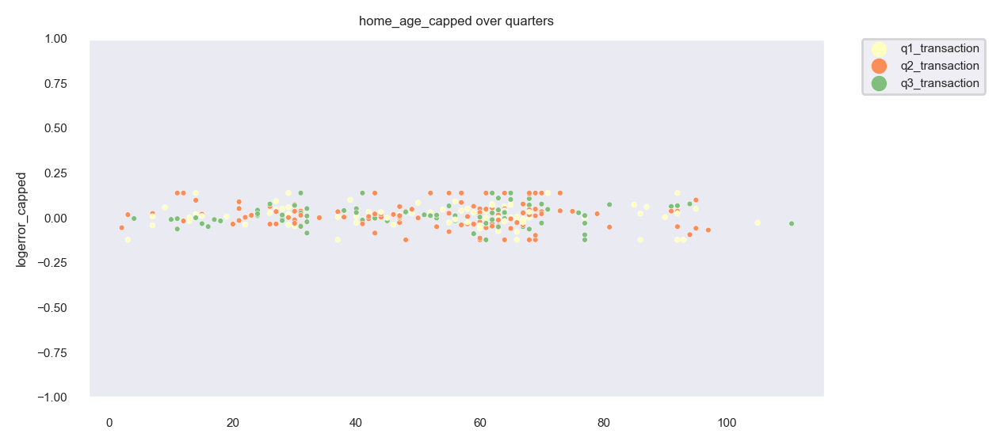

In [218]:
# viewing the log error relationship across continuous features, and transaction quarters

num_lst = [
 'living_sq_feet_capped',
 'home_value_capped',
 'property_sq_feet_capped',
 'year_built_capped',
 'home_age_capped']

for col in num_lst:
    plt.figure(figsize = (6,3))
    sns.set(style = "dark", font_scale = .5)
    ax = sns.scatterplot(x = col,
        y = "logerror_capped",
        data = train_imputed.sample(300),
        hue = "transaction_quarter",
        hue_order = ["q1_transaction", "q2_transaction", "q3_transaction"],
        palette = ["#ffffbf", "#fc8d59", "#7fbf7b"],
        sizes = (20,600),
        s = 6)

    # removing scientific notation
    ax.ticklabel_format(style = "plain")

    plt.title(f'{col} over quarters')
    plt.ylim(-1, 1)
    plt.xlabel(None)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)
    # plt.savefig(title, dpi=300)

    plt.show()

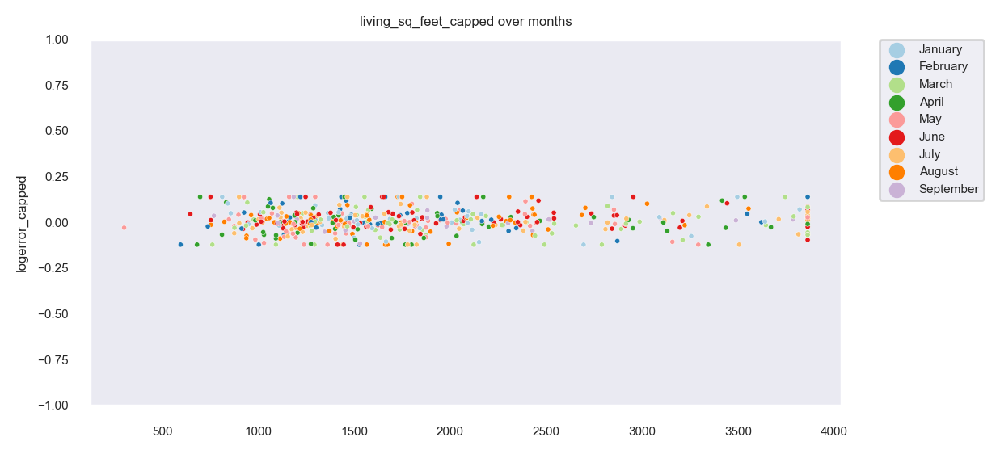

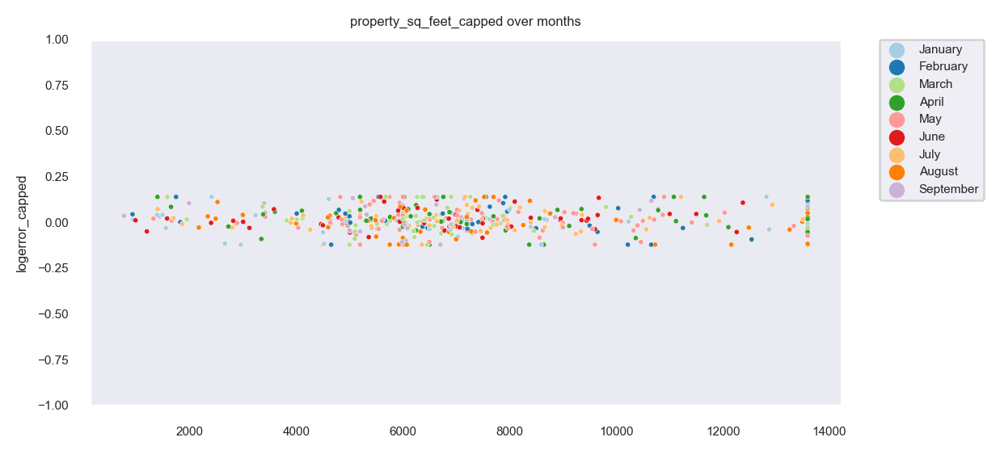

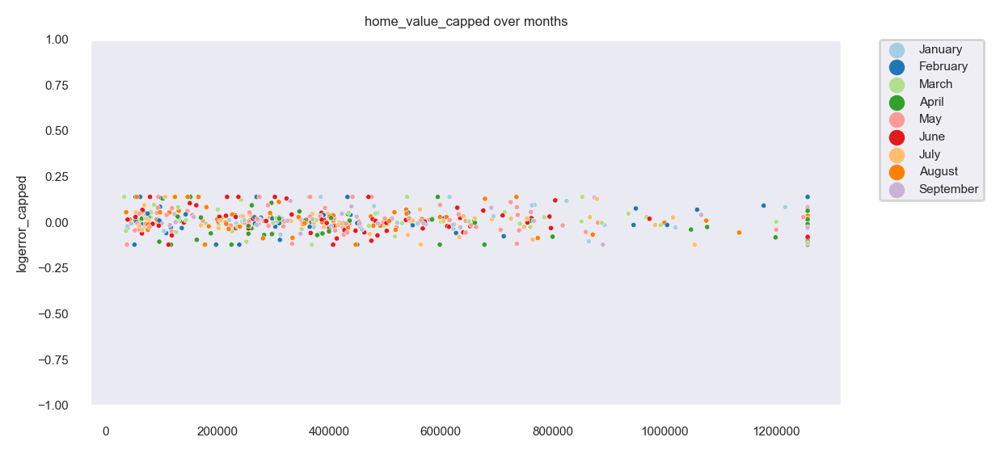

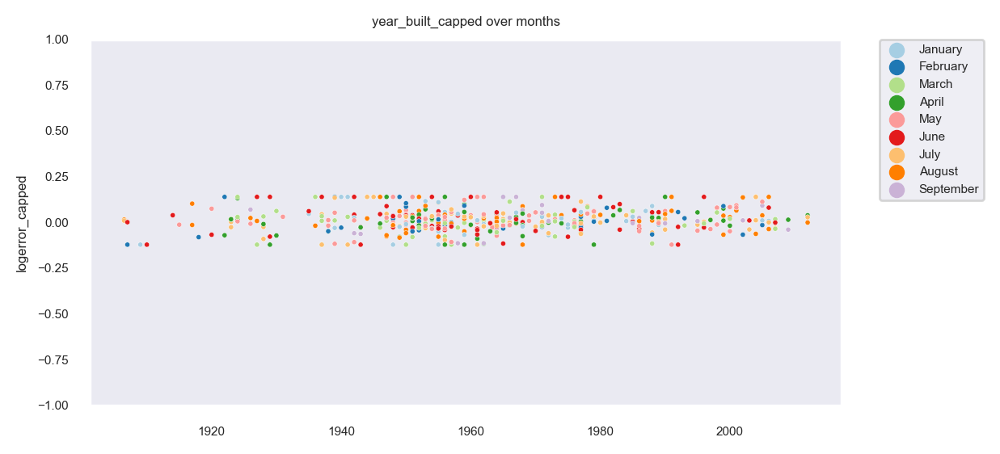

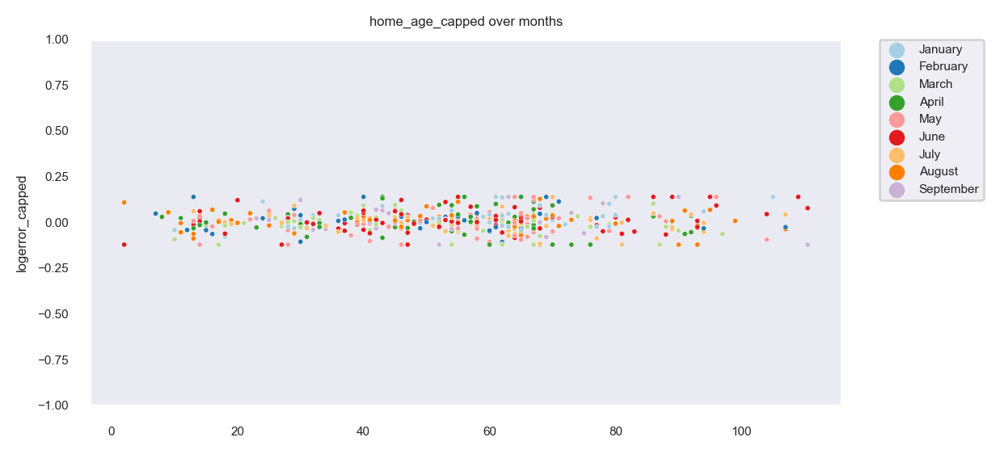

In [219]:
# viewing the log error relationship across continuous features, and transaction months

num_lst = [
    'living_sq_feet_capped',
    'property_sq_feet_capped',
    'home_value_capped',
    'year_built_capped',
    'home_age_capped']

for col in num_lst:
    plt.figure(figsize = (6,3))
    sns.set(style = "dark", font_scale = .5)
    ax = sns.scatterplot(x = col,
        y = "logerror_capped",
        data = train_imputed.sample(500),
        hue = "transaction_month",
        hue_order = [
            'January',
            'February',
            'March',
            'April',
            'May',
            'June',
            'July',
            'August',
            'September'],
        palette = ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6'],
        sizes = (20,600),
        s = 5)
    
    # removing scientific notation
    ax.ticklabel_format(style = "plain") 
    

    plt.title(f'{col} over months')
    plt.ylim(-1, 1)
    plt.xlabel(None)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

    plt.show()

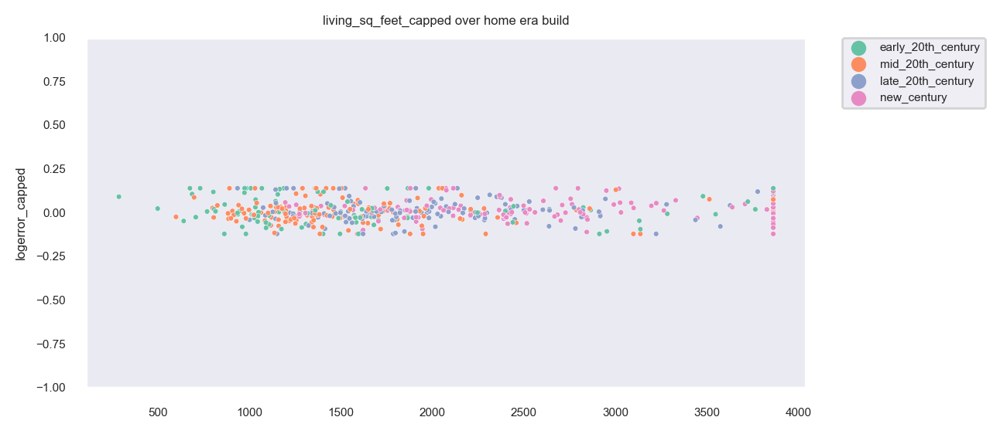

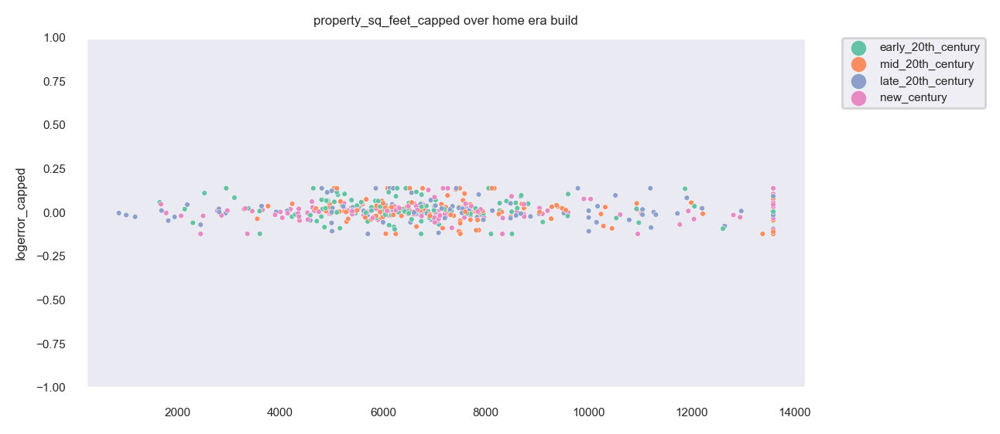

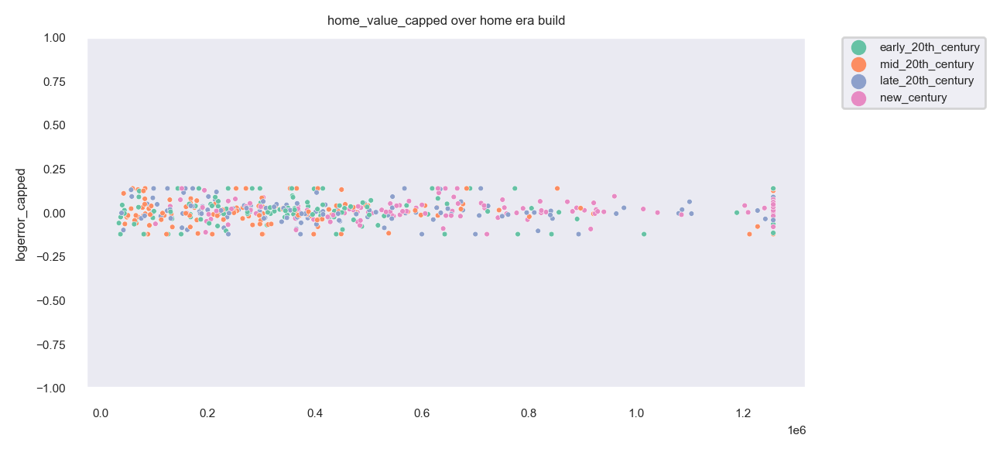

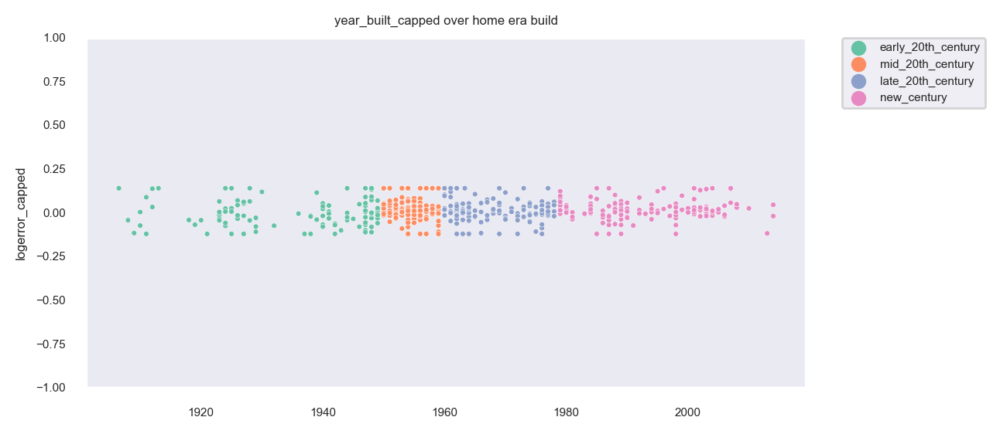

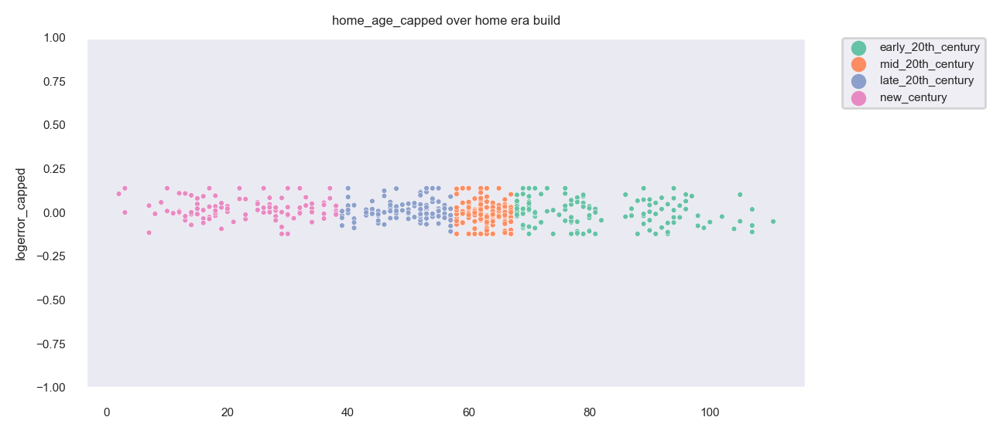

In [220]:
# viewing the log error relationship across continuous features, and home build era

num_lst = [
    'living_sq_feet_capped',
    'property_sq_feet_capped',
    'home_value_capped',
    'year_built_capped',
    'home_age_capped']


for col in num_lst:
    plt.figure(figsize = (6,3))
    sns.set(style = "dark", font_scale = .5)
    sns.scatterplot(x = col,
        y = "logerror_capped",
        data = train_imputed.sample(500),
        hue = "home_age_binned",
        hue_order = ['early_20th_century', 'mid_20th_century', 'late_20th_century', 'new_century'],
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3'],
        sizes = (20,600),
        s = 6)

    plt.title(f'{col} over home era build')
    plt.ylim(-1, 1)
    plt.xlabel(None)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

    plt.show()

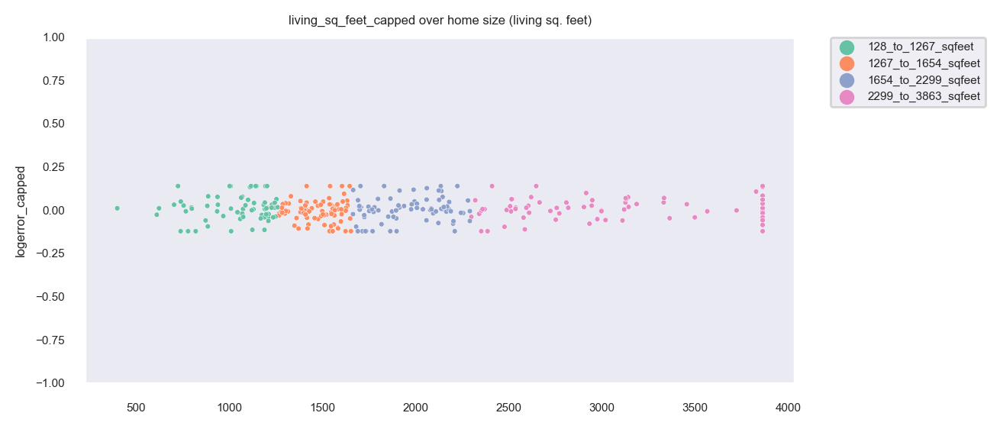

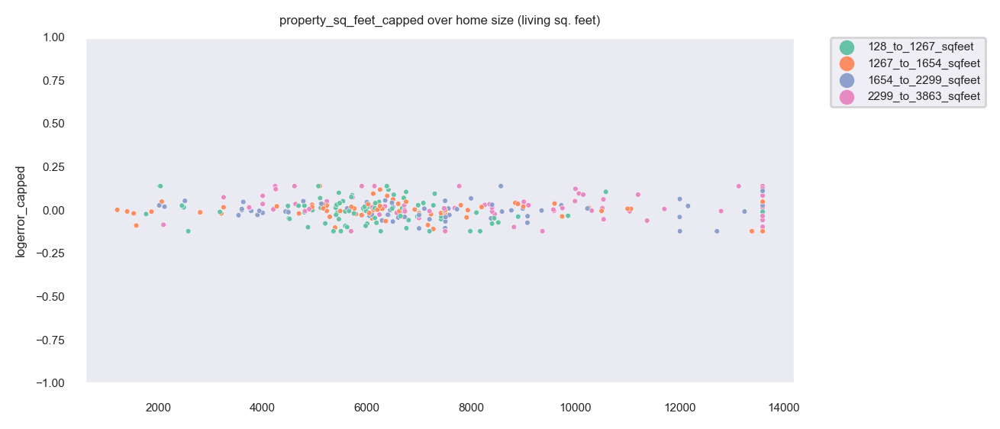

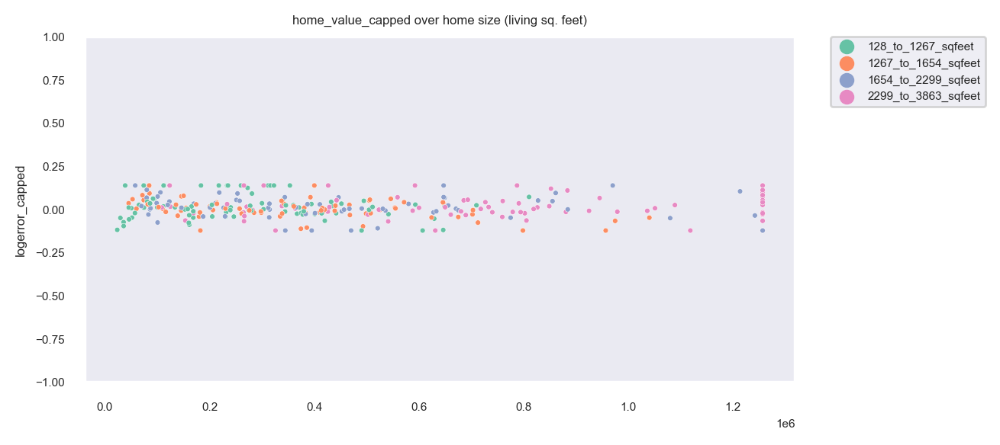

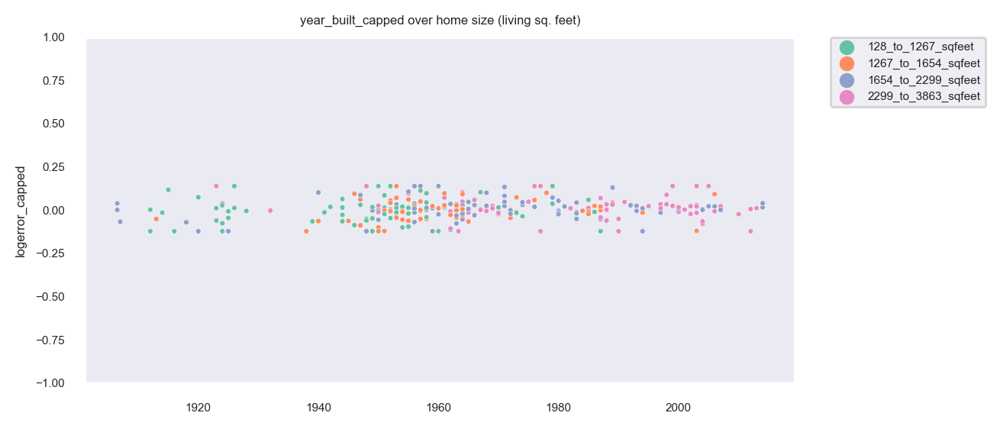

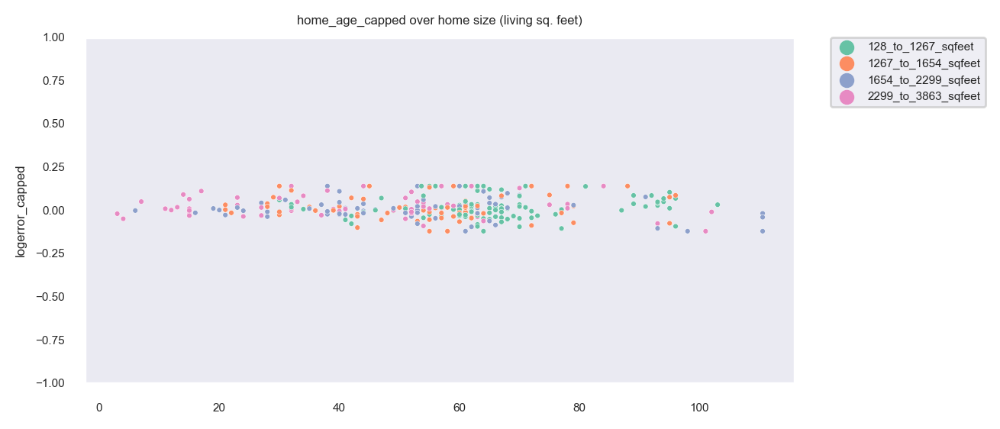

In [221]:
# viewing the log error relationship across continuous features, and home size (living sq. feet)

num_lst = [
    'living_sq_feet_capped',
    'property_sq_feet_capped',
    'home_value_capped',
    'year_built_capped',
    'home_age_capped']

for col in num_lst:
    plt.figure(figsize = (6,3))
    sns.set(style = "dark", font_scale = .5)
    sns.scatterplot(x = col,
        y = "logerror_capped",
        data = train_imputed.sample(300),
        hue = "living_sqfeet_binned",
        hue_order = ['128_to_1267_sqfeet', '1267_to_1654_sqfeet', '1654_to_2299_sqfeet', '2299_to_3863_sqfeet'],
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3'],
        sizes = (20,600),
        s = 6)

    plt.title(f'{col} over home size (living sq. feet)')
    plt.ylim(-1, 1)
    plt.xlabel(None)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

    plt.show()

In [222]:
disc_values = list(train_imputed["transaction_quarter"].unique())
disc_values

['q1_transaction', 'q3_transaction', 'q2_transaction']

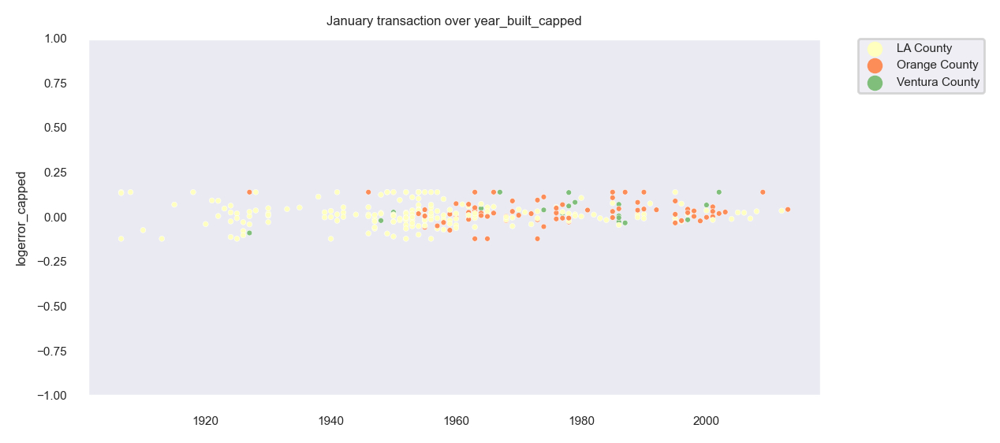

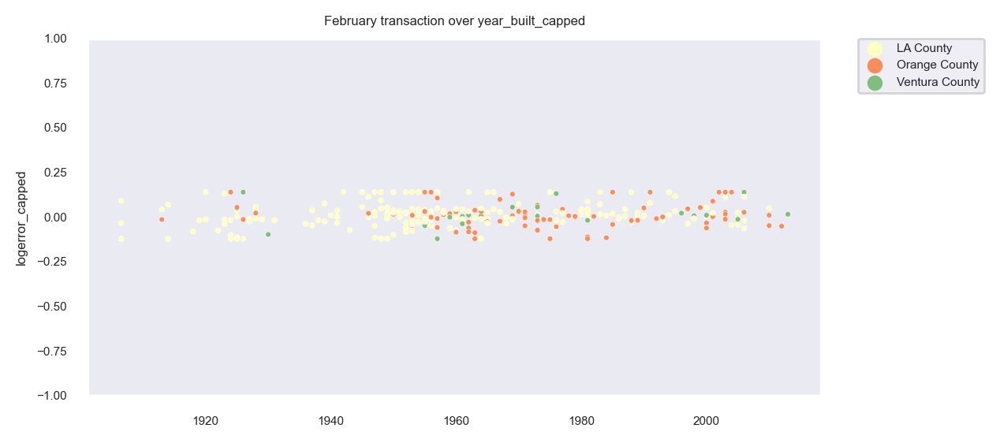

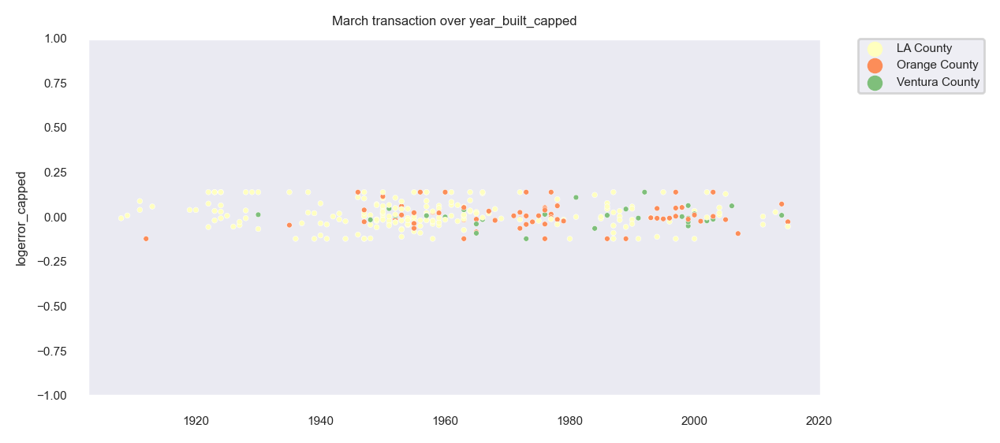

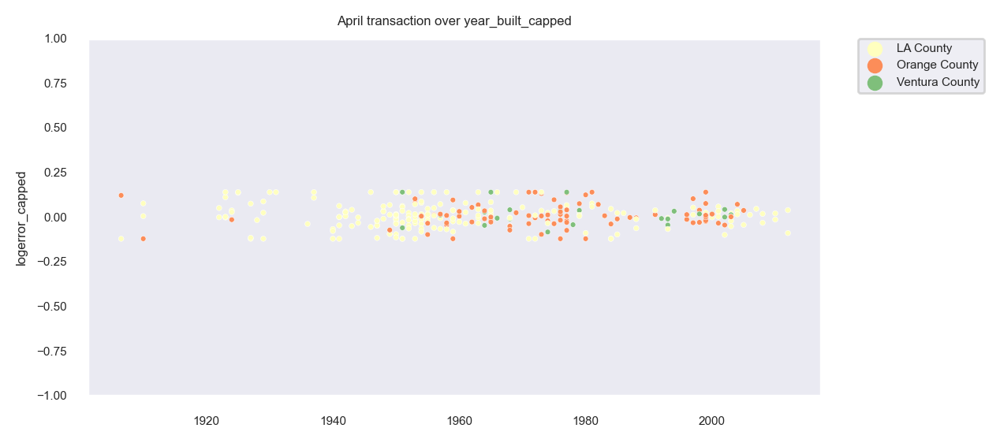

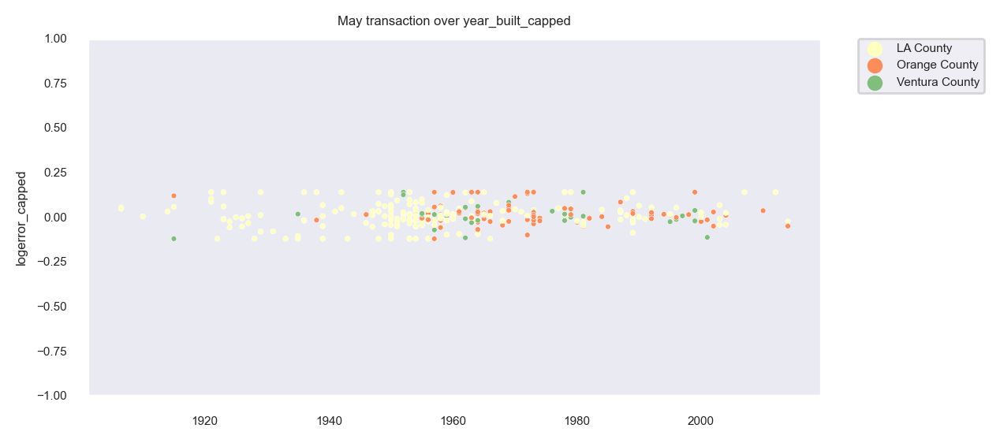

...

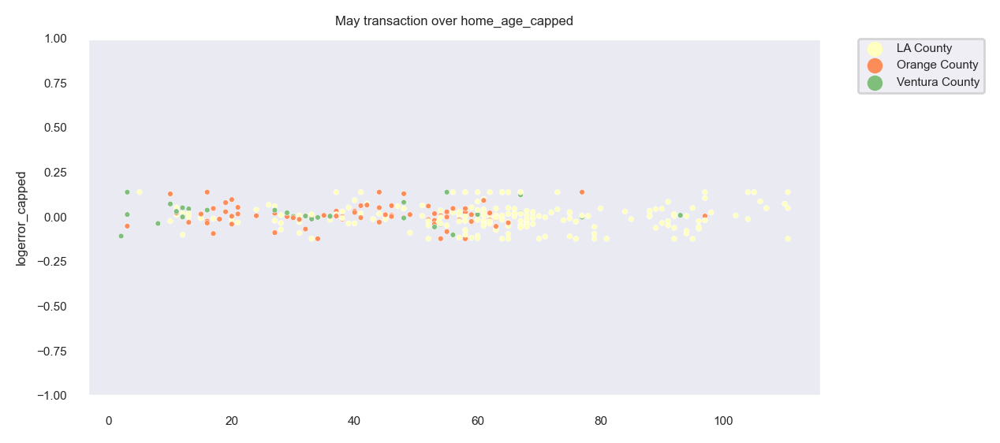

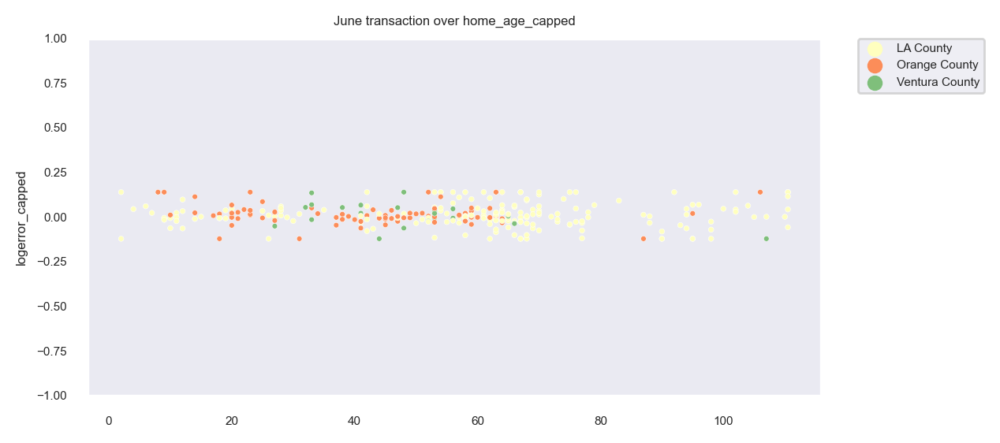

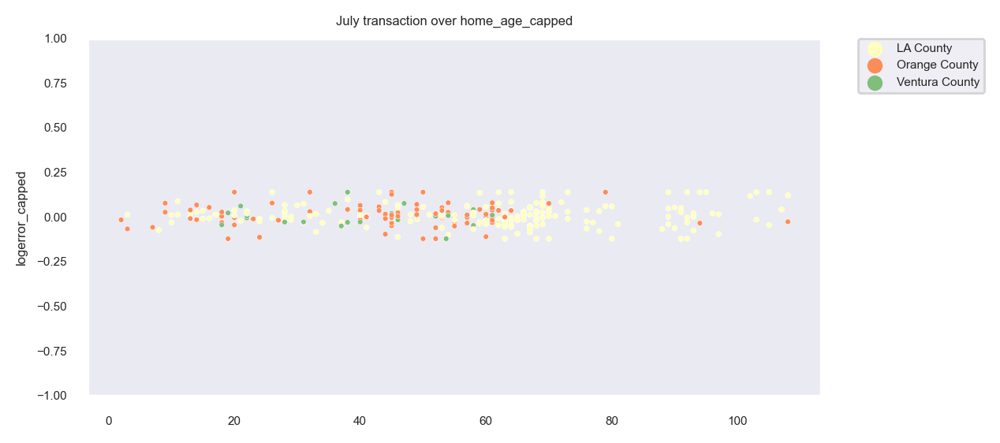

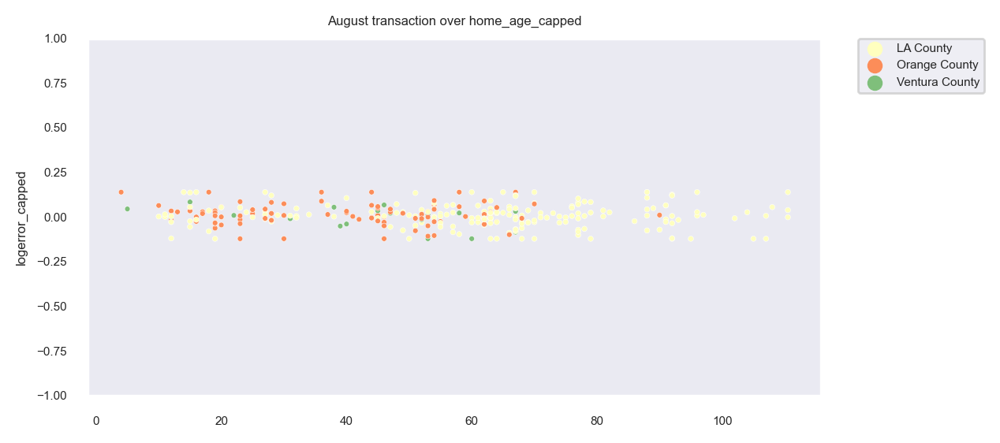

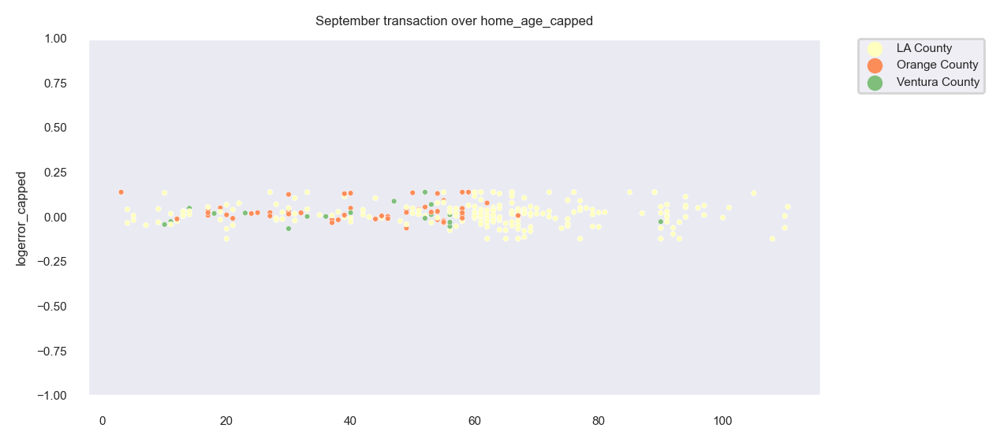

In [223]:
# example 1

num_lst = ['year_built_capped', 'home_age_capped']
disc_values = ['q1_transaction', 'q3_transaction', 'q2_transaction']

months_order = [
            'January',
            'February',
            'March',
            'April',
            'May',
            'June',
            'July',
            'August',
            'September']

for col in num_lst:
 
    for ele in months_order:

        plt.figure(figsize = (6,3))
        sns.set(style = "dark", font_scale = .5)

        df = train_imputed[train_imputed["transaction_month"] == ele]

        sns.scatterplot(x = col,
            y = "logerror_capped",
            data = df.sample(300),
            hue = "county_by_fips",
            hue_order = ["LA County", "Orange County", "Ventura County"],
            palette = ["#ffffbf", "#fc8d59", "#7fbf7b"],
            sizes = (20,600),
            s = 6)

        plt.title(f'{ele} transaction over {col}')
        plt.ylim(-1, 1)
        plt.xlabel(None)
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0)

        plt.show()

------
### ``Question #1: Is there a difference in log error across the three (3) counties?``

<u>**``Conducting ANOVA analysis across examined features``**</u>

**Null Hypothesis:** "There's **not** a statistical log error variance difference across features."

**Alternative Hypothesis:** "There **is** a statistical log error variance difference across features."

$\alpha$: 0.05

In [224]:
# setting the alpha value

confidence_interval = 0.95
alpha = 1 - confidence_interval

County: LA County
logerror: 0.004458083226532755
-------------------------
County: Orange County
logerror: 0.0032935107141482136
-------------------------
County: Ventura County
logerror: 0.0031414742394895935
-------------------------


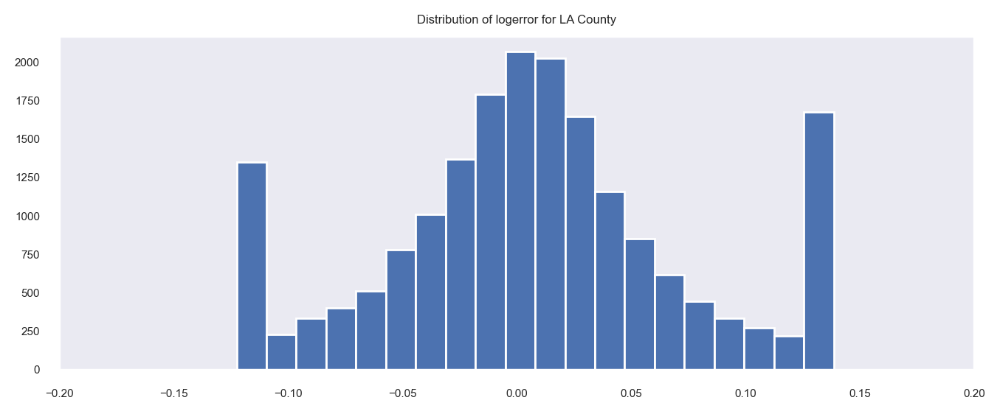

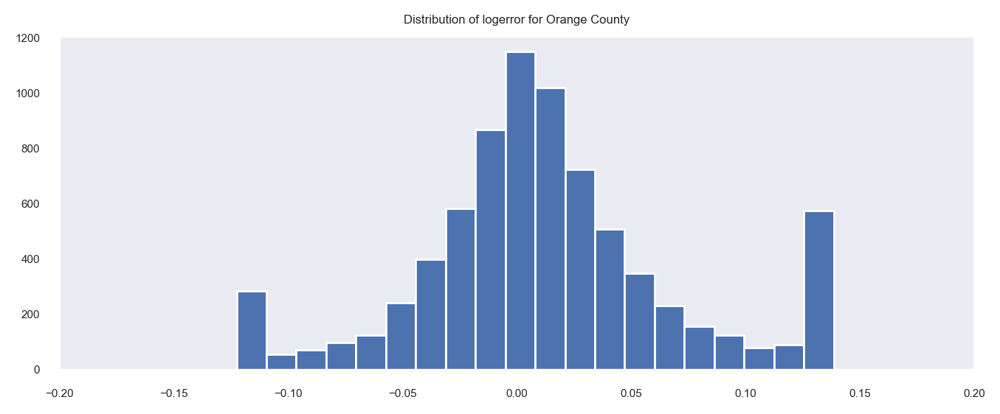

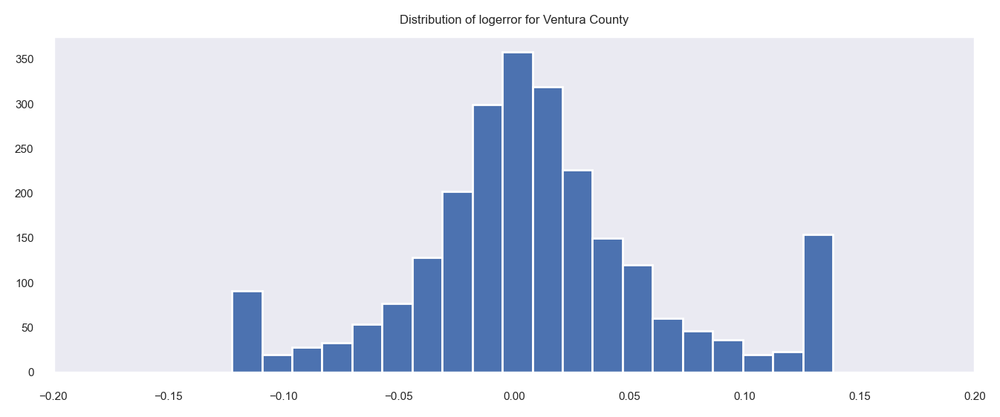

In [225]:
# Question Number #1:
# is there a difference in log error across the three (3) counties?

county_lst = list(train_imputed["county_by_fips"].unique())

for ele in county_lst:
    print(f'County: {ele}')
    print(f'logerror: {train_imputed[train_imputed["county_by_fips"] == ele].logerror_capped.var()}')
    print('-------------------------')

    plt.figure(figsize = (8,3))
    plt.xlim(-.2, .2)

    plt.title('Distribution of logerror for {}'.format(ele))
    plt.hist(train_imputed[train_imputed["county_by_fips"] == ele].logerror_capped, bins = 20)

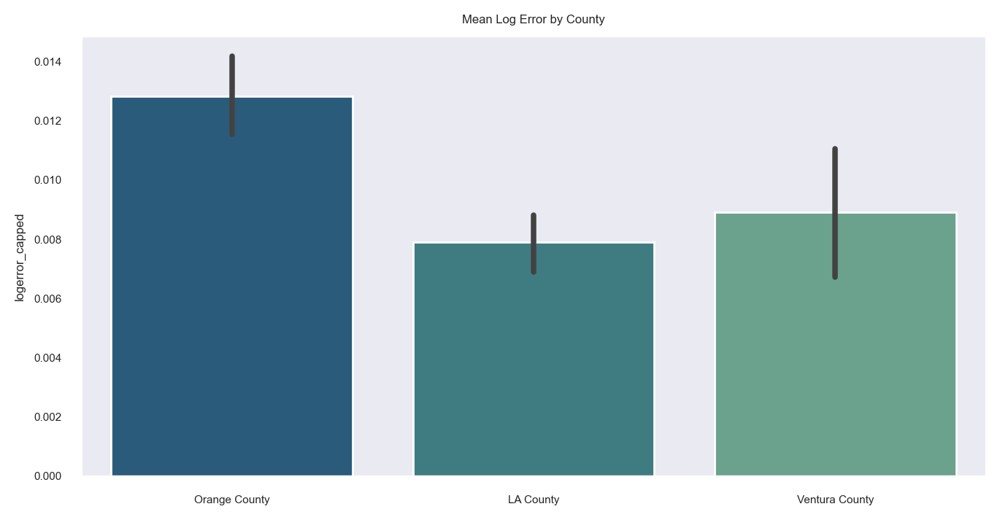

In [226]:
# average log error across counties

plt.figure(figsize = (8, 4))
sns.barplot(
    x = "county_by_fips", 
    y = "logerror_capped", 
    data = train_imputed,
    order = ["Orange County", "LA County", "Ventura County"],
    palette = "crest_r")

plt.title("Mean Log Error by County")
plt.xlabel(None)
plt.show()

In [227]:
# conducting levene test to assess variance

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[train_imputed["county_by_fips"] == "LA County"].logerror_capped,
    train_imputed[train_imputed["county_by_fips"] == "Orange County"].logerror_capped,
    train_imputed[train_imputed["county_by_fips"] == "Ventura County"].logerror_capped)

# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are relatively equal.')

f statistic = 171.30053
p value = 0.0
-----------------
We reject the null hypothesis. Variances are not equal.


In [228]:
# ANOVA hypothesis test

f_statistic, p_value = stats.f_oneway(
    train_imputed[train_imputed["county_by_fips"] == "LA County"].logerror_capped,
    train_imputed[train_imputed["county_by_fips"] == "Orange County"].logerror_capped,
    train_imputed[train_imputed["county_by_fips"] == "Ventura County"].logerror_capped)


# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis.')
else:
    print('We fail to reject the null hypothesis.')

f statistic = 16.66794
p value = 0.0
-----------------
We reject the null hypothesis.


------
### ``Question #2: Is there a difference in log error across home eras?``

**Null Hypothesis:** "There's **not** a statistical log error variance difference across features."

**Alternative Hypothesis:** "There **is** a statistical log error variance difference across features."

$\alpha$: 0.05

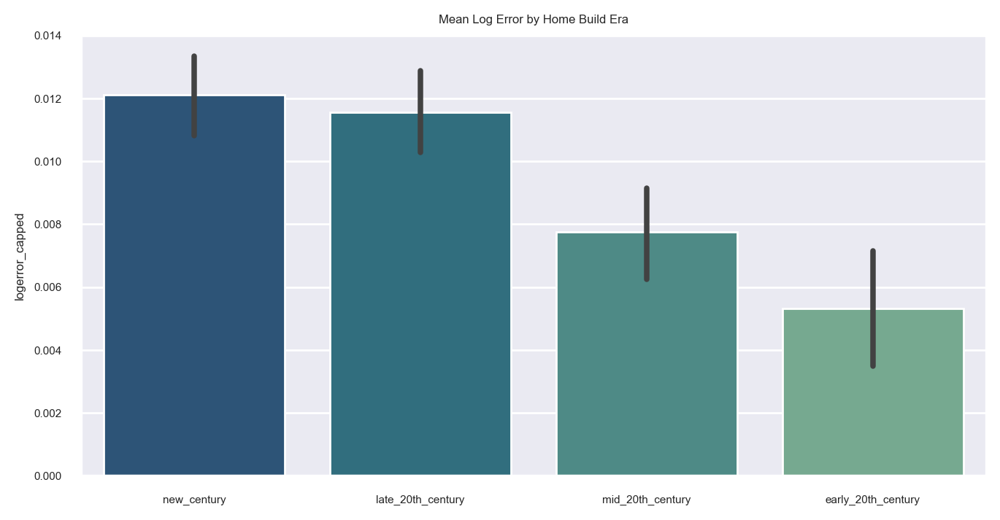

In [229]:
# average log error across home era

plt.figure(figsize = (8, 4))
sns.set(font_scale = 0.5)

sns.barplot(
    x = "home_age_binned", 
    y = "logerror_capped", 
    data = train_imputed,
    palette = "crest_r")

plt.title("Mean Log Error by Home Build Era")
plt.xlabel(None)
plt.show()

In [230]:
# conducting a lavene's test to assess variance

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[train_imputed["home_age_binned"] == "new_century"].logerror_capped,
    train_imputed[train_imputed["home_age_binned"] == "mid_20th_century"].logerror_capped,
    train_imputed[train_imputed["home_age_binned"] == "early_20th_century"].logerror_capped,
    train_imputed[train_imputed["home_age_binned"] == "late_20th_century"].logerror_capped)

# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are equal.')

f statistic = 320.39489
p value = 0.0
-----------------
We reject the null hypothesis. Variances are not equal.


In [231]:
# ANOVA hypothesis test for: home era

f_statistic, p_value = stats.f_oneway(
    train_imputed[train_imputed["home_age_binned"] == "new_century"].logerror_capped,
    train_imputed[train_imputed["home_age_binned"] == "late_20th_century"].logerror_capped,
    train_imputed[train_imputed["home_age_binned"] == "mid_20th_century"].logerror_capped,
    train_imputed[train_imputed["home_age_binned"] == "early_20th_century"].logerror_capped)


# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Means are different across the groups.')
else:
    print('We fail to reject the null hypothesis. Means are similar across the groups.')

f statistic = 18.45057
p value = 0.0
-----------------
We reject the null hypothesis. Means are different across the groups.


----
### ``Question #3: Is there a difference in log error across home era in Orange County?``

**Null Hypothesis:** There's not a logerror variance difference across home eras in Orange County.

**Althernative Hypothesis:** There is a logerror variance difference across home eras in Orange County.

In [232]:
# setting the alpha value

alpha = 0.05

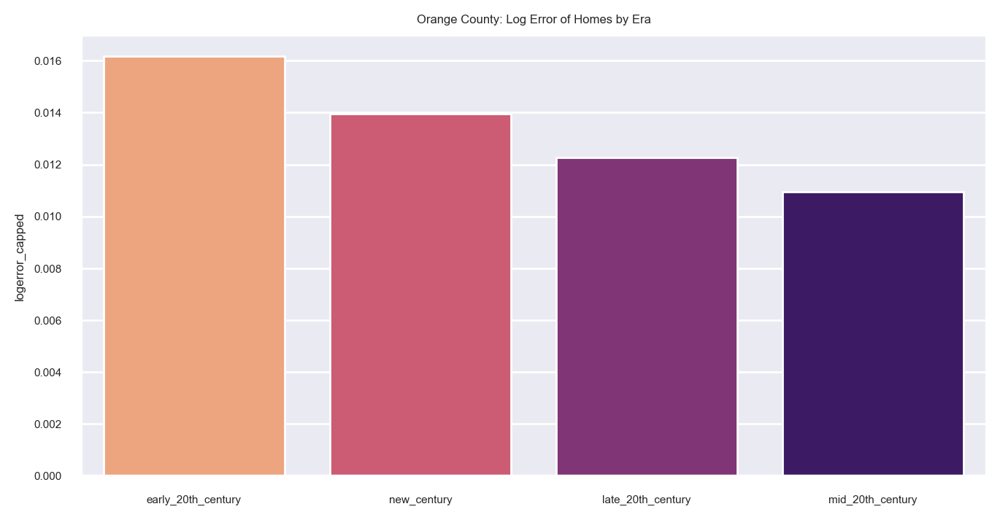

In [233]:
# is there a difference in logerror across orange county and the home build era?

county_lst = list(train_imputed["county_by_fips"].unique())
home_era = list(train_imputed["home_age_binned"].unique())

plt.figure(figsize = (8, 4))
sns.barplot(
    x = "home_age_binned",
    y = train_imputed[train_imputed["county_by_fips"] == "Orange County"].logerror_capped,
    data = train_imputed,
    order = ["early_20th_century", "new_century", "late_20th_century", "mid_20th_century"], 
    ci = None,
    palette = "magma_r")

plt.title("Orange County: Log Error of Homes by Era")
plt.xlabel(None)
plt.show()

In [234]:
# conducting levene test to assess variance across build era and orange county

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[(train_imputed["home_age_binned"] == "new_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["home_age_binned"] == "mid_20th_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["home_age_binned"] == "early_20th_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["home_age_binned"] == "late_20th_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped)

# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are relatively equal.')

f statistic = 54.12399
p value = 0.0
-----------------
We reject the null hypothesis. Variances are not equal.


In [235]:
# ANOVA hypothesis test for: home era

f_statistic, p_value = stats.f_oneway(
    train_imputed[(train_imputed["home_age_binned"] == "new_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["home_age_binned"] == "mid_20th_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["home_age_binned"] == "early_20th_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["home_age_binned"] == "late_20th_century") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped)

# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Means are different across the groups.')
else:
    print('We fail to reject the null hypothesis. Means are similar across the groups.')

f statistic = 1.3387
p value = 0.25982
-----------------
We fail to reject the null hypothesis. Means are similar across the groups.


----
### ``Question #4: Is there a difference in log error across transaction quarter?``

**Null Hypothesis:** "There's **not** a statistical log error variance difference across features."

**Alternative Hypothesis:** "There **is** a statistical log error variance difference across features."

$\alpha$: 0.05

In [236]:
# setting the alpha value

alpha = 0.05

In [237]:
# checking the dataframe

train_imputed.head()

,parcel_id,home_value_capped,logerror_capped,bathroom_count_capped,bedroom_count_capped,living_sq_feet_capped,county_by_fips,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,home_age_capped,transaction_month,home_age_binned,living_sqfeet_binned,transaction_quarter
7961,12167890,912304.00,0.14,3.00,3.00,1903.00,LA County,34204513.00,-118131241.00,10704.00,0100,60374602.00,1957.00,60.00,February,mid_20th_century,1654_to_2299_sqfeet,q1_transaction
47936,10933324,1256382.50,0.01,3.00,4.00,2108.00,LA County,34147955.00,-118350425.00,8432.00,0100,60371431.00,1935.00,82.00,August,early_20th_century,1654_to_2299_sqfeet,q3_transaction
20730,10917682,850525.00,-0.04,4.00,4.00,2446.00,LA County,34135818.00,-118407312.00,9568.00,0100,60371439.01,1962.00,55.00,April,late_20th_century,2299_to_3863_sqfeet,q2_transaction
1988,11437314,510000.00,-0.05,1.00,3.00,1120.00,LA County,33893976.00,-118334891.00,5250.00,0101,60376037.02,1953.00,64.00,January,mid_20th_century,128_to_1267_sqfeet,q1_transaction
45959,12738926,343172.00,0.03,2.00,3.00,1918.00,LA County,33910440.00,-118013069.00,7936.00,0100,60375040.01,1958.00,59.00,August,mid_20th_century,1654_to_2299_sqfeet,q3_transaction


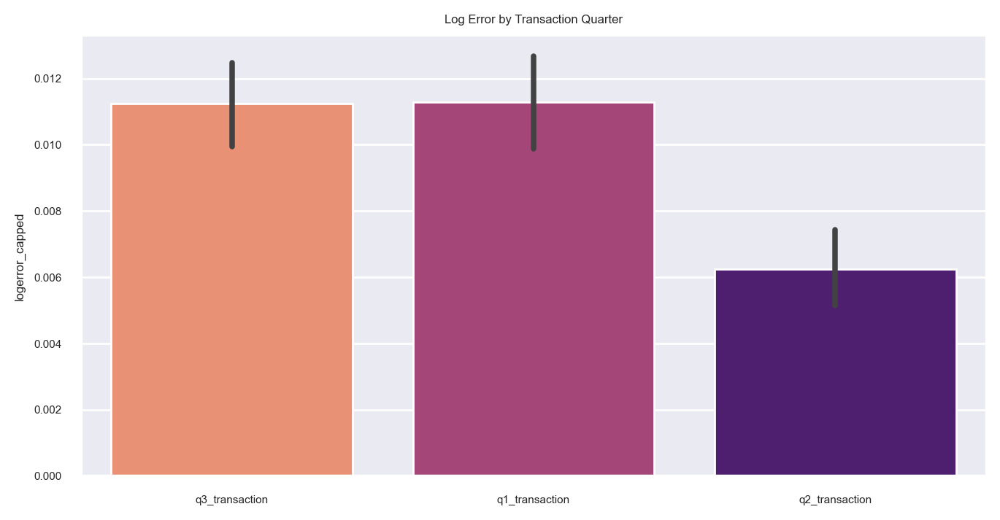

In [238]:
# plotting home transactions by quarters

plt.figure(figsize = (8, 4))
sns.set(font_scale = 0.5)
plt.xlabel(None)

sns.barplot(
    x = "transaction_quarter",
    y = "logerror_capped",
    data = train_imputed,
    order = ["q3_transaction", "q1_transaction", "q2_transaction"], 
    palette = "magma_r")

plt.title("Log Error by Transaction Quarter")
plt.xlabel(None)
plt.show()

In [239]:
# conducting levene test to assess variance

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[train_imputed["transaction_quarter"] == "q1_transaction"].logerror_capped,
    train_imputed[train_imputed["transaction_quarter"] == "q2_transaction"].logerror_capped,
    train_imputed[train_imputed["transaction_quarter"] == "q3_transaction"].logerror_capped)

# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are relatively equal.')

f statistic = 19.76949
p value = 0.0
-----------------
We reject the null hypothesis. Variances are not equal.


In [240]:
# ANOVA hypothesis test for: transactions by quarter

f_statistic, p_value = stats.f_oneway(
    train_imputed[train_imputed["transaction_quarter"] == "q1_transaction"].logerror_capped,
    train_imputed[train_imputed["transaction_quarter"] == "q2_transaction"].logerror_capped,
    train_imputed[train_imputed["transaction_quarter"] == "q3_transaction"].logerror_capped)

# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Means are different across the groups.')
else:
    print('We fail to reject the null hypothesis. Means are similar across the groups.')

f statistic = 21.65676
p value = 0.0
-----------------
We reject the null hypothesis. Means are different across the groups.


----
### ``Question #5: Is there a difference in log error across transaction month?``

**Null Hypothesis:** "There's **not** a statistical log error variance difference across features."

**Alternative Hypothesis:** "There **is** a statistical log error variance difference across features."

$\alpha$: 0.05 

In [241]:
# let's get a list of all the months

lst_of_months = list(train["transaction_month"].unique())
lst_of_months # checks out!

['February',
 'August',
 'April',
 'January',
 'March',
 'September',
 'July',
 'May',
 'June']

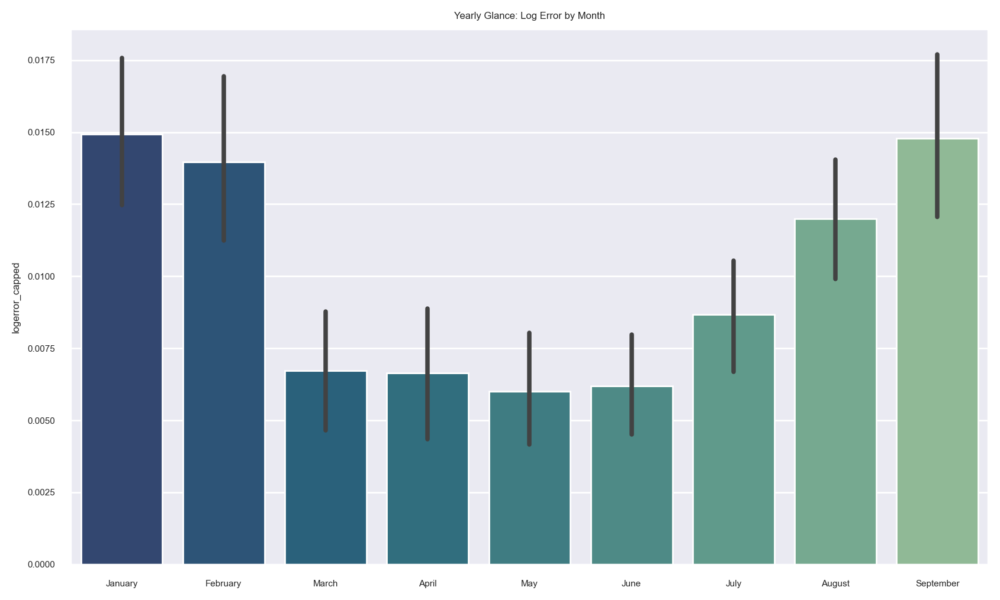

In [242]:
# plotting log error for all months

plt.figure(figsize = (10, 6))
sns.barplot(x = "transaction_month",
    y = "logerror_capped", 
    data = train_imputed,
    order = [
    'January',
    'February',
    'March',
    'April',
    'May',
    'June',
    'July',
    'August',
    'September'],
    palette = "crest_r",
    ci = 95)

plt.title("Yearly Glance: Log Error by Month")
plt.xlabel(None)
plt.show()

In [243]:
# conducting levene test to assess variance

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[train_imputed["transaction_month"] == "January"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "February"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "March"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "April"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "May"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "June"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "July"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "August"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "September"].logerror_capped)

# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are relatively equal.')

f statistic = 7.09908
p value = 0.0
-----------------
We reject the null hypothesis. Variances are not equal.


In [244]:
# ANOVA hypothesis test for: transactions by quarter

f_statistic, p_value = stats.f_oneway(
    train_imputed[train_imputed["transaction_month"] == "January"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "February"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "March"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "April"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "May"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "June"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "July"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "August"].logerror_capped,
    train_imputed[train_imputed["transaction_month"] == "September"].logerror_capped)

# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Means are different across the groups.')
else:
    print('We fail to reject the null hypothesis. Means are similar across the groups.')

f statistic = 10.82788
p value = 0.0
-----------------
We reject the null hypothesis. Means are different across the groups.


----
### ``Question #6: Is there a difference across home transaction months in Orange County?``

**Null Hypothesis:** There's not a logerror variance difference across transaction months in Orange County.

**Althernative Hypothesis:** There is a logerror variance difference across transaction months in Orange County.

$\alpha$: 0.05

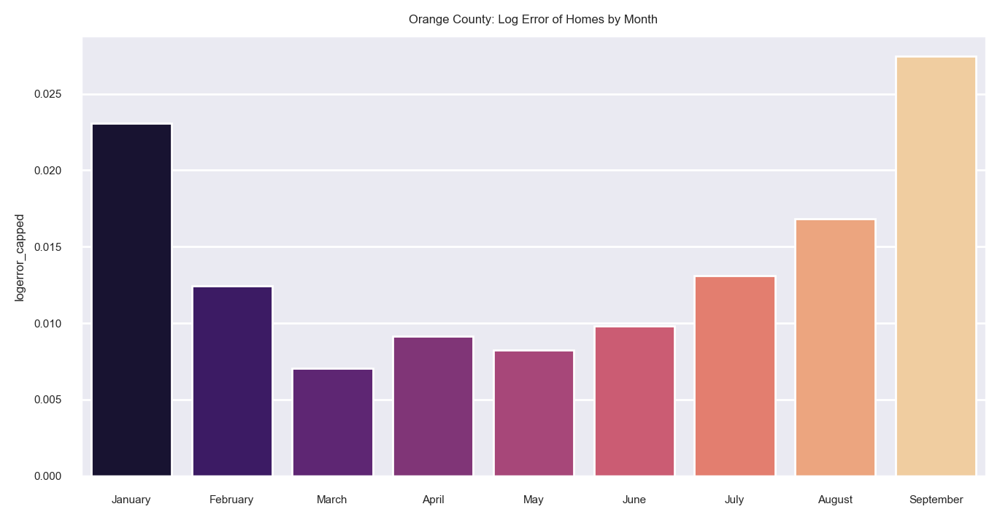

In [245]:
county_lst = list(train_imputed["county_by_fips"].unique())
home_era = list(train_imputed["home_age_binned"].unique())

plt.figure(figsize = (8, 4))
sns.barplot(
    x = "transaction_month",
    y = train_imputed[train_imputed["county_by_fips"] == "Orange County"].logerror_capped,
    data = train_imputed, 
    ci = None,
    order = [
    'January',
    'February',
    'March',
    'April',
    'May',
    'June',
    'July',
    'August',
    'September'],
    palette = "magma")

plt.title("Orange County: Log Error of Homes by Month")
plt.xlabel(None)
plt.show()

In [246]:
# conducting levene test to assess variance

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[(train_imputed["transaction_month"] == "January") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "February") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "March")& (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "April") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "May") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "June") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "July") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "August") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "September") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped)

# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are relatively equal.')

f statistic = 3.46873
p value = 0.00053
-----------------
We reject the null hypothesis. Variances are not equal.


In [247]:
# ANOVA hypothesis test for: transactions by quarter in Orange County

f_statistic, p_value = stats.f_oneway(
   train_imputed[(train_imputed["transaction_month"] == "January") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "February") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "March")& (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "April") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "May") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "June") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "July") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "August") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped,
    train_imputed[(train_imputed["transaction_month"] == "September") & (train_imputed["county_by_fips"] == "Orange County")].logerror_capped)

# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Means are different across the groups.')
else:
    print('We fail to reject the null hypothesis. Means are similar across the groups.')

f statistic = 9.41597
p value = 0.0
-----------------
We reject the null hypothesis. Means are different across the groups.


----
### ``Question #7: Is there a difference in log error across grouped home sizes (binned sq-feet)?``

**Null Hypothesis:** There's not a logerror variance difference across group home sizes.

**Althernative Hypothesis:** There is a logerror variance difference across group home sizes.

$\alpha$: 0.05

In [248]:
size_lst = list(train_imputed["living_sqfeet_binned"].unique().sort_values())
size_lst

['128_to_1267_sqfeet',
 '1267_to_1654_sqfeet',
 '1654_to_2299_sqfeet',
 '2299_to_3863_sqfeet']

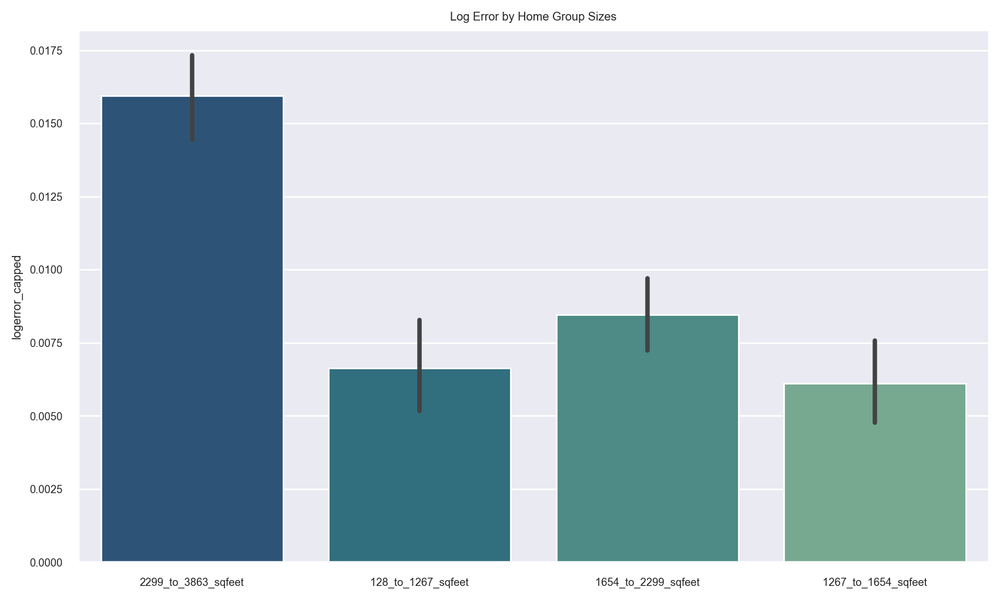

In [249]:
# creating a for loop to bar plot log error for all months

plt.figure(figsize = (10, 6))
sns.set(font_scale = 0.6)
sns.barplot(x = "living_sqfeet_binned",
    y = "logerror_capped", 
    data = train_imputed,
    order = [
        '2299_to_3863_sqfeet',
        '128_to_1267_sqfeet',
        '1654_to_2299_sqfeet',
        '1267_to_1654_sqfeet'],
    palette = "crest_r",
    ci = 95)

plt.title("Log Error by Home Group Sizes")
plt.xlabel(None)
plt.show()

In [250]:
# conducting levene test to assess variance

#H0: Variances are equal
#Ha: Variances are not equal

l_stat, p_value = stats.levene(
    train_imputed[train_imputed["living_sqfeet_binned"] == '128_to_1267_sqfeet'].logerror_capped,
    train_imputed[train_imputed["living_sqfeet_binned"] == '1267_to_1654_sqfeet'].logerror_capped,
    train_imputed[train_imputed["living_sqfeet_binned"] == '1654_to_2299_sqfeet'].logerror_capped,
    train_imputed[train_imputed["living_sqfeet_binned"] == '2299_to_3863_sqfeet'].logerror_capped)


# comparing the counties p_value to alpha
print(f'f statistic = {l_stat.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Variances are not equal.')
else:
    print('We fail to reject the null hypothesis. Variances are relatively equal.')

f statistic = 65.61224
p value = 0.0
-----------------
We reject the null hypothesis. Variances are not equal.


In [251]:
# ANOVA hypothesis test for: home size groups

f_statistic, p_value = stats.f_oneway(
    train_imputed[train_imputed["living_sqfeet_binned"] == '128_to_1267_sqfeet'].logerror_capped,
    train_imputed[train_imputed["living_sqfeet_binned"] == '1267_to_1654_sqfeet'].logerror_capped,
    train_imputed[train_imputed["living_sqfeet_binned"] == '1654_to_2299_sqfeet'].logerror_capped,
    train_imputed[train_imputed["living_sqfeet_binned"] == '2299_to_3863_sqfeet'].logerror_capped)

# comparing the counties p_value to alpha
print(f'f statistic = {f_statistic.round(5)}')
print(f'p value = {p_value.round(5)}')
print("-----------------")

if p_value < alpha:
    print('We reject the null hypothesis. Means are different across the groups.')
else:
    print('We fail to reject the null hypothesis. Means are similar across the groups.')

f statistic = 37.63541
p value = 0.0
-----------------
We reject the null hypothesis. Means are different across the groups.


----
### ``Hypothesis Testing on Independent Features:``

In [252]:
# checking the df head 

train_imputed.head()

,parcel_id,home_value_capped,logerror_capped,bathroom_count_capped,bedroom_count_capped,living_sq_feet_capped,county_by_fips,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,home_age_capped,transaction_month,home_age_binned,living_sqfeet_binned,transaction_quarter
7961,12167890,912304.00,0.14,3.00,3.00,1903.00,LA County,34204513.00,-118131241.00,10704.00,0100,60374602.00,1957.00,60.00,February,mid_20th_century,1654_to_2299_sqfeet,q1_transaction
47936,10933324,1256382.50,0.01,3.00,4.00,2108.00,LA County,34147955.00,-118350425.00,8432.00,0100,60371431.00,1935.00,82.00,August,early_20th_century,1654_to_2299_sqfeet,q3_transaction
20730,10917682,850525.00,-0.04,4.00,4.00,2446.00,LA County,34135818.00,-118407312.00,9568.00,0100,60371439.01,1962.00,55.00,April,late_20th_century,2299_to_3863_sqfeet,q2_transaction
1988,11437314,510000.00,-0.05,1.00,3.00,1120.00,LA County,33893976.00,-118334891.00,5250.00,0101,60376037.02,1953.00,64.00,January,mid_20th_century,128_to_1267_sqfeet,q1_transaction
45959,12738926,343172.00,0.03,2.00,3.00,1918.00,LA County,33910440.00,-118013069.00,7936.00,0100,60375040.01,1958.00,59.00,August,mid_20th_century,1654_to_2299_sqfeet,q3_transaction


In [253]:
col_lst = train_imputed.columns.tolist()
col_lst

['parcel_id',
 'home_value_capped',
 'logerror_capped',
 'bathroom_count_capped',
 'bedroom_count_capped',
 'living_sq_feet_capped',
 'county_by_fips',
 'latitude',
 'longitude',
 'property_sq_feet_capped',
 'county_zoning_code',
 'blockgroup_assignment',
 'year_built_capped',
 'home_age_capped',
 'transaction_month',
 'home_age_binned',
 'living_sqfeet_binned',
 'transaction_quarter']

In [254]:
# let's generate dummy variables for the following and scale our data

# transaction month
# home age binned
# living sq feet binned
# transaction quarters

# train dataset
train_dummy = pd.get_dummies(data = train_imputed, columns = [
    'transaction_month', 
    'home_age_binned',
    'bathroom_count_capped',
    'bedroom_count_capped',
    'county_by_fips',
    'living_sqfeet_binned',
    'transaction_quarter'],
    drop_first = False, 
    dtype = bool)

# validate dataset
validate_dummy = pd.get_dummies(data = validate_imputed, columns = [
    'transaction_month', 
    'home_age_binned',
    'bathroom_count_capped',
    'bedroom_count_capped',
    'county_by_fips',
    'living_sqfeet_binned',
    'transaction_quarter'],
    drop_first = False, 
    dtype = bool)

# test dataset
test_dummy = pd.get_dummies(data = test_imputed, columns = [
    'transaction_month', 
    'home_age_binned',
    'bathroom_count_capped',
    'bedroom_count_capped',
    'county_by_fips',
    'living_sqfeet_binned',
    'transaction_quarter'],
    drop_first = False, 
    dtype = bool)

# checking the train dataset
train_dummy.head()

,parcel_id,home_value_capped,logerror_capped,living_sq_feet_capped,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,...,county_by_fips_LA County,county_by_fips_Orange County,county_by_fips_Ventura County,living_sqfeet_binned_128_to_1267_sqfeet,living_sqfeet_binned_1267_to_1654_sqfeet,living_sqfeet_binned_1654_to_2299_sqfeet,living_sqfeet_binned_2299_to_3863_sqfeet,transaction_quarter_q1_transaction,transaction_quarter_q2_transaction,transaction_quarter_q3_transaction
7961,12167890,912304.00,0.14,1903.00,34204513.00,-118131241.00,10704.00,0100,60374602.00,1957.00,...,True,False,False,False,False,True,False,True,False,False
47936,10933324,1256382.50,0.01,2108.00,34147955.00,-118350425.00,8432.00,0100,60371431.00,1935.00,...,True,False,False,False,False,True,False,False,False,True
20730,10917682,850525.00,-0.04,2446.00,34135818.00,-118407312.00,9568.00,0100,60371439.01,1962.00,...,True,False,False,False,False,False,True,False,True,False
1988,11437314,510000.00,-0.05,1120.00,33893976.00,-118334891.00,5250.00,0101,60376037.02,1953.00,...,True,False,False,True,False,False,False,True,False,False
45959,12738926,343172.00,0.03,1918.00,33910440.00,-118013069.00,7936.00,0100,60375040.01,1958.00,...,True,False,False,False,False,True,False,False,False,True


In [255]:
#column dtypes

train_dummy.dtypes.sort_values(ascending = False)

parcel_id                                    object
county_zoning_code                           object
property_sq_feet_capped                     float64
home_value_capped                           float64
home_age_capped                             float64
blockgroup_assignment                       float64
year_built_capped                           float64
longitude                                   float64
latitude                                    float64
living_sq_feet_capped                       float64
logerror_capped                             float64
county_by_fips_LA County                       bool
bathroom_count_capped_4.5                      bool
bedroom_count_capped_1.5                       bool
bedroom_count_capped_2.0                       bool
bedroom_count_capped_3.0                       bool
bedroom_count_capped_4.0                       bool
bedroom_count_capped_5.0                       bool
bedroom_count_capped_5.5                       bool
living_sqfee

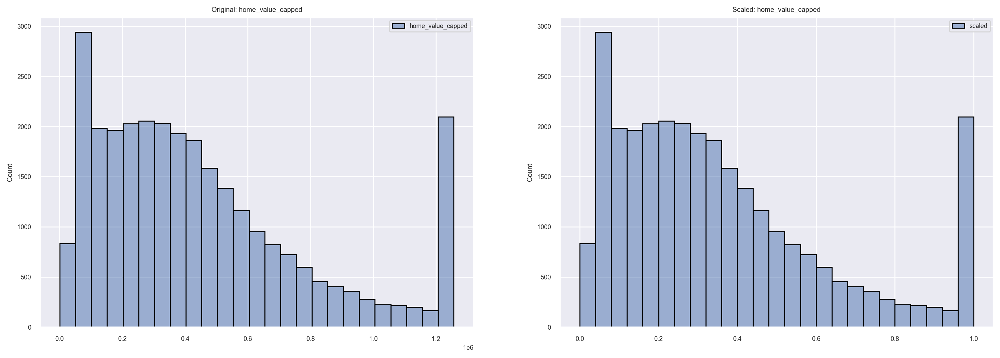

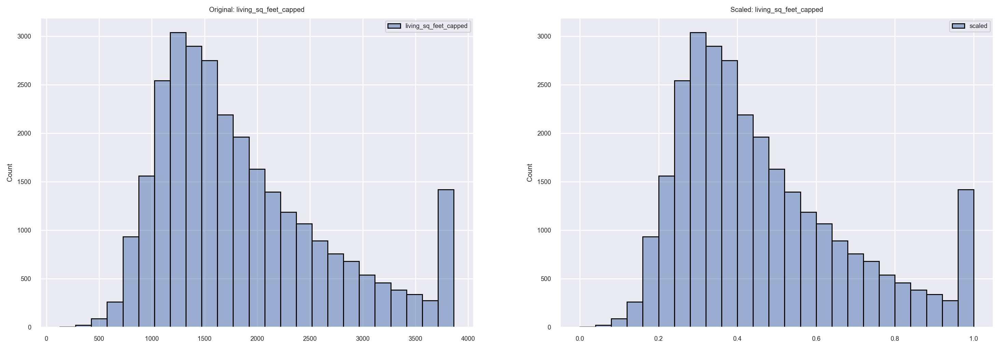

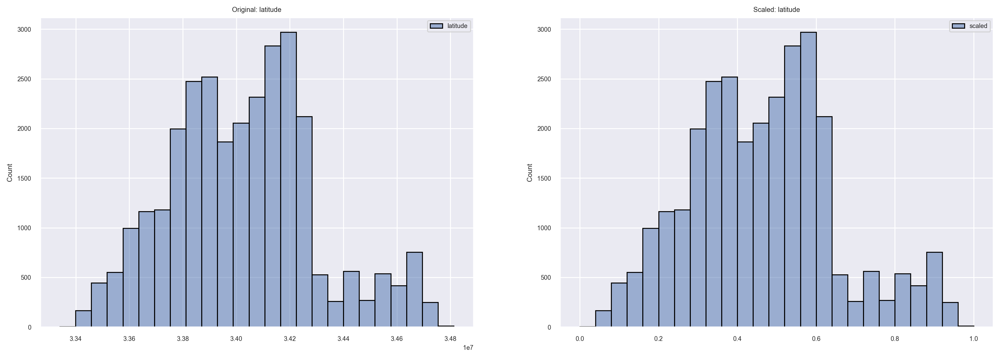

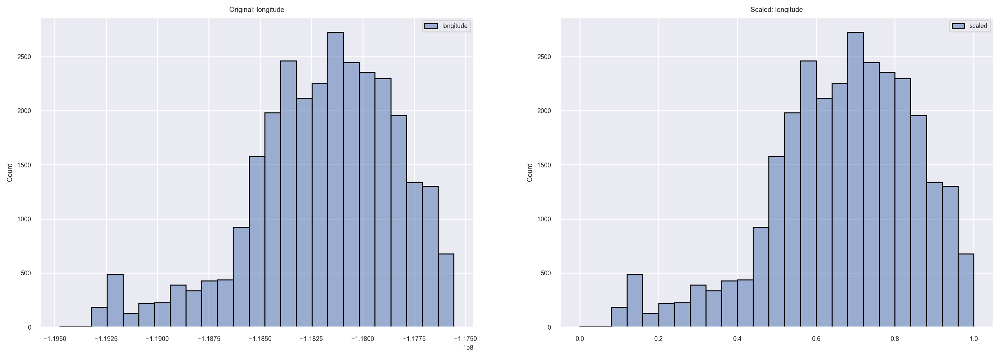

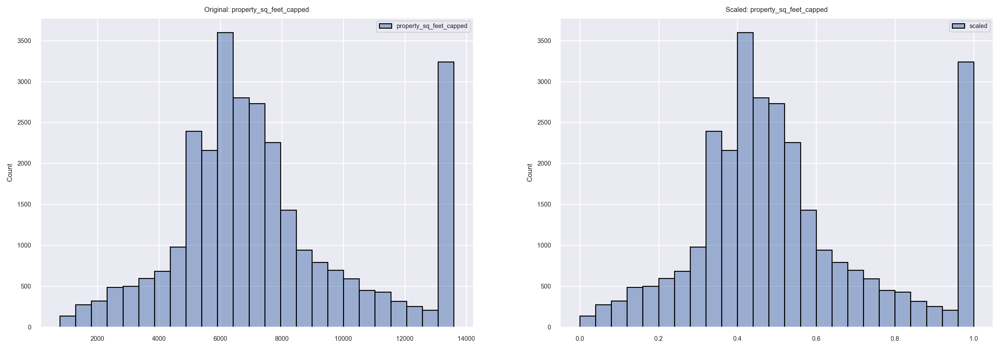

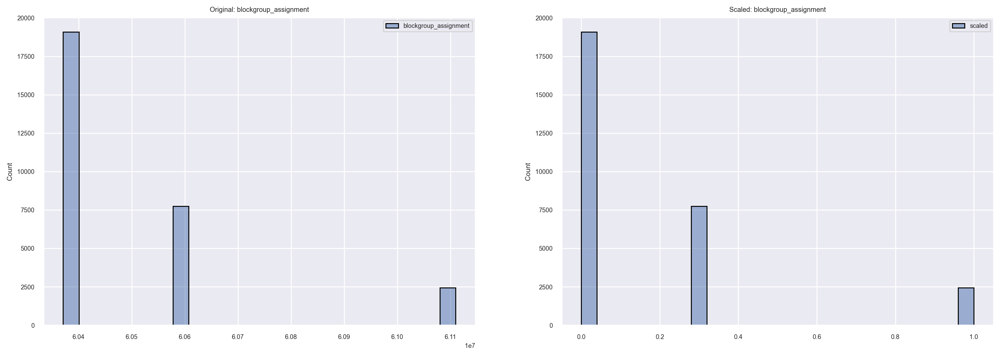

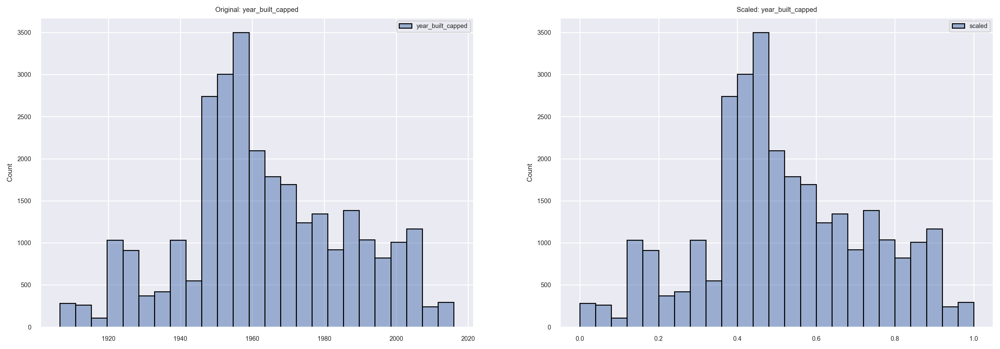

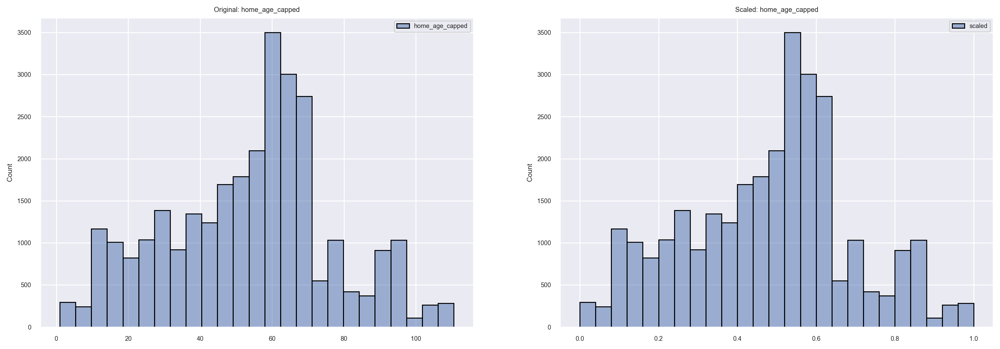

In [256]:
cont_lst = train_dummy.select_dtypes(exclude = ["object", "category", "uint8", "int64", "bool"]).columns.tolist()
cont_lst = [ele for ele in cont_lst if ele not in ("logerror_capped", "home_value")]

for col in cont_lst:
    scaler = MinMaxScaler()
    scaler.fit(train_dummy[[col]])

    x_scaled = scaler.transform(train_dummy[[col]])

    plt.figure(figsize=(18, 6))
    plt.subplot(121)
    sns.histplot(train_dummy[[col]], bins = 25, edgecolor = 'black', label = col)
    
    plt.title(f'Original: {col}')
    plt.legend()

    plt.subplot(122)
    ax = sns.histplot(x_scaled, bins=25, edgecolor = 'black', label = "scaled")
    
    # removing axes scientific notation 
    ax.ticklabel_format(style = "plain") 
    plt.title(f'Scaled: {col}')
    plt.legend()

In [257]:
# scaling necessary features in datasets

scaler = MinMaxScaler()
scaler.fit(train_dummy[cont_lst])

# dummy datasets
train_dummy[cont_lst] = scaler.transform(train_dummy[cont_lst])
validate_dummy[cont_lst] = scaler.transform(validate_dummy[cont_lst])
test_dummy[cont_lst] = scaler.transform(test_dummy[cont_lst])

# non-dummy datasets
train_imputed[cont_lst] = scaler.transform(train_imputed[cont_lst])
validate_imputed[cont_lst] = scaler.transform(validate_imputed[cont_lst])
test_imputed[cont_lst] = scaler.transform(test_imputed[cont_lst])

In [258]:
# let's check the scaler worked

train_dummy.head() # checks out!

,parcel_id,home_value_capped,logerror_capped,living_sq_feet_capped,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,...,county_by_fips_LA County,county_by_fips_Orange County,county_by_fips_Ventura County,living_sqfeet_binned_128_to_1267_sqfeet,living_sqfeet_binned_1267_to_1654_sqfeet,living_sqfeet_binned_1654_to_2299_sqfeet,living_sqfeet_binned_2299_to_3863_sqfeet,transaction_quarter_q1_transaction,transaction_quarter_q2_transaction,transaction_quarter_q3_transaction
7961,12167890,0.73,0.14,0.48,0.59,0.70,0.77,0100,0.00,0.46,...,True,False,False,False,False,True,False,True,False,False
47936,10933324,1.00,0.01,0.53,0.55,0.59,0.60,0100,0.00,0.26,...,True,False,False,False,False,True,False,False,False,True
20730,10917682,0.68,-0.04,0.62,0.54,0.56,0.69,0100,0.00,0.51,...,True,False,False,False,False,False,True,False,True,False
1988,11437314,0.41,-0.05,0.27,0.38,0.59,0.35,0101,0.01,0.42,...,True,False,False,True,False,False,False,True,False,False
45959,12738926,0.27,0.03,0.48,0.39,0.76,0.56,0100,0.01,0.47,...,True,False,False,False,False,True,False,False,False,True


In [259]:
# training dataset columns

train_dummy.columns.tolist()

['parcel_id',
 'home_value_capped',
 'logerror_capped',
 'living_sq_feet_capped',
 'latitude',
 'longitude',
 'property_sq_feet_capped',
 'county_zoning_code',
 'blockgroup_assignment',
 'year_built_capped',
 'home_age_capped',
 'transaction_month_April',
 'transaction_month_August',
 'transaction_month_February',
 'transaction_month_January',
 'transaction_month_July',
 'transaction_month_June',
 'transaction_month_March',
 'transaction_month_May',
 'transaction_month_September',
 'home_age_binned_new_century',
 'home_age_binned_late_20th_century',
 'home_age_binned_mid_20th_century',
 'home_age_binned_early_20th_century',
 'bathroom_count_capped_0.5',
 'bathroom_count_capped_1.0',
 'bathroom_count_capped_1.5',
 'bathroom_count_capped_2.0',
 'bathroom_count_capped_2.5',
 'bathroom_count_capped_3.0',
 'bathroom_count_capped_3.5',
 'bathroom_count_capped_4.0',
 'bathroom_count_capped_4.5',
 'bedroom_count_capped_1.5',
 'bedroom_count_capped_2.0',
 'bedroom_count_capped_3.0',
 'bedroom_c

In [260]:
disc_lst = train_dummy.select_dtypes(exclude = "number").columns.tolist()
disc_lst

['parcel_id',
 'county_zoning_code',
 'transaction_month_April',
 'transaction_month_August',
 'transaction_month_February',
 'transaction_month_January',
 'transaction_month_July',
 'transaction_month_June',
 'transaction_month_March',
 'transaction_month_May',
 'transaction_month_September',
 'home_age_binned_new_century',
 'home_age_binned_late_20th_century',
 'home_age_binned_mid_20th_century',
 'home_age_binned_early_20th_century',
 'bathroom_count_capped_0.5',
 'bathroom_count_capped_1.0',
 'bathroom_count_capped_1.5',
 'bathroom_count_capped_2.0',
 'bathroom_count_capped_2.5',
 'bathroom_count_capped_3.0',
 'bathroom_count_capped_3.5',
 'bathroom_count_capped_4.0',
 'bathroom_count_capped_4.5',
 'bedroom_count_capped_1.5',
 'bedroom_count_capped_2.0',
 'bedroom_count_capped_3.0',
 'bedroom_count_capped_4.0',
 'bedroom_count_capped_5.0',
 'bedroom_count_capped_5.5',
 'county_by_fips_LA County',
 'county_by_fips_Orange County',
 'county_by_fips_Ventura County',
 'living_sqfeet_bin

In [261]:
# setting features to cluster on 

X_month = train_dummy[[
    'home_age_capped',
    'transaction_month_January',
    'transaction_month_February',
    'transaction_month_March',
    'transaction_month_April',
    'transaction_month_May',
    'transaction_month_June',
    'transaction_month_July',
    'transaction_month_August',
    'transaction_month_September'
    ]]

# val df
X_val = validate_dummy[[
    'home_age_capped',
    'transaction_month_January',
    'transaction_month_February',
    'transaction_month_March',
    'transaction_month_April',
    'transaction_month_May',
    'transaction_month_June',
    'transaction_month_July',
    'transaction_month_August',
    'transaction_month_September'
    ]]

# test df
X_test = test_dummy[[
    'home_age_capped',
    'transaction_month_January',
    'transaction_month_February',
    'transaction_month_March',
    'transaction_month_April',
    'transaction_month_May',
    'transaction_month_June',
    'transaction_month_July',
    'transaction_month_August',
    'transaction_month_September'
    ]]

X_month.head()

,home_age_capped,transaction_month_January,transaction_month_February,transaction_month_March,transaction_month_April,transaction_month_May,transaction_month_June,transaction_month_July,transaction_month_August,transaction_month_September
7961,0.54,False,True,False,False,False,False,False,False,False
47936,0.74,False,False,False,False,False,False,False,True,False
20730,0.49,False,False,False,True,False,False,False,False,False
1988,0.58,True,False,False,False,False,False,False,False,False
45959,0.53,False,False,False,False,False,False,False,True,False


In [262]:
# initial fitting of KMeans cluster

kmeans = KMeans(n_clusters = 9)
kmeans.fit(X_month)

train_clusters = kmeans.predict(X_month)

train_clusters

array([7, 0, 5, ..., 5, 8, 3], dtype=int32)

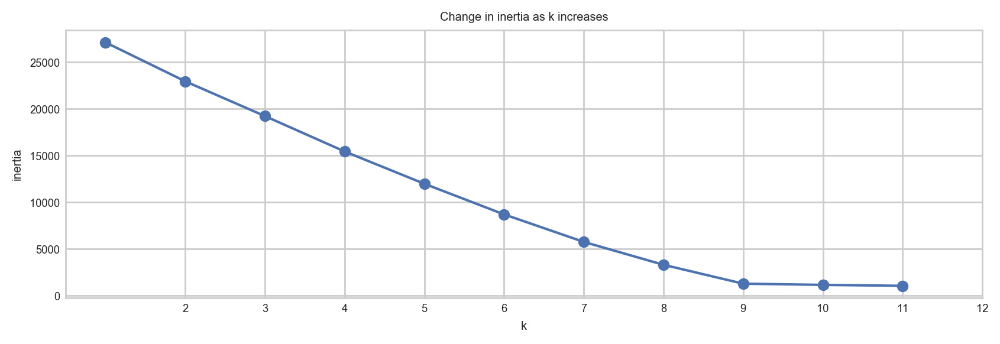

In [263]:
with plt.style.context('seaborn-whitegrid'):

    plt.figure(figsize=(10, 3))
    pd.Series({k: KMeans(k).fit(X_month).inertia_ for k in range(1, 12)}).plot(marker = 'o')
    plt.xticks(range(2, 13))
    
    plt.xlabel('k')
    plt.ylabel('inertia')
    plt.title('Change in inertia as k increases')

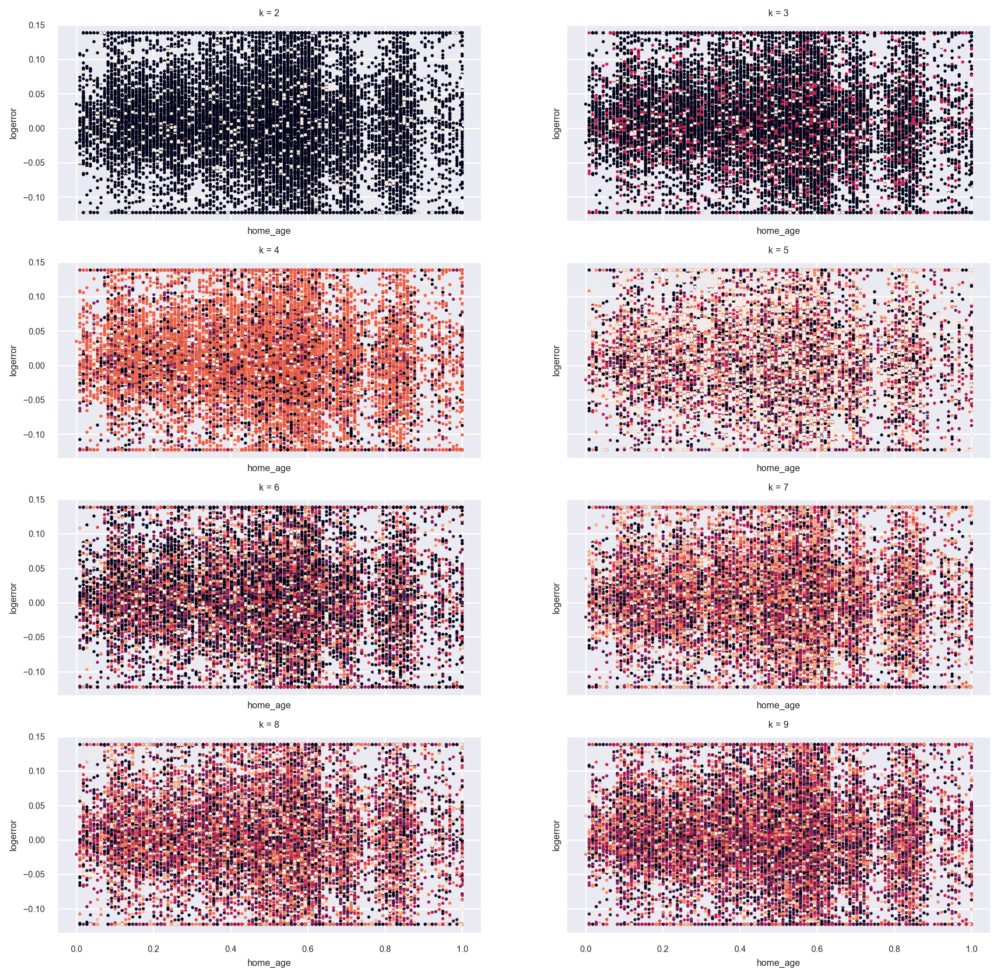

In [264]:
# plotting inertia for number of KMeans clusters

fig, axs = plt.subplots(4, 2, figsize=(13, 13), sharex=True, sharey=True)

for ax, k in zip(axs.ravel(), range(2, 13)):
    
    # creating and fitting KMeans
    clusters = KMeans(k).fit(X_month).predict(X_month)

    X_month["logerror_capped"] = train_dummy["logerror_capped"]

    ax.scatter(
        X_month["home_age_capped"], 
        X_month["logerror_capped"], 
        c = clusters,
        s = 2)

    ax.set(title='k = {}'.format(k), xlabel = 'home_age', ylabel = 'logerror')

In [265]:
# cleaning target in KMeans cluster and creating val and test clusters

X_month = X_month.drop(columns = "logerror_capped")

kmeans = KMeans(n_clusters = 9)
kmeans.fit(X_month)

train_age_clusters = kmeans.predict(X_month)
val_age_clusters = kmeans.predict(X_val)
test_age_clusters = kmeans.predict(X_test)

train_age_clusters

array([7, 2, 5, ..., 5, 8, 3], dtype=int32)

In [266]:
# checking for cleaning

X_month.head()

,home_age_capped,transaction_month_January,transaction_month_February,transaction_month_March,transaction_month_April,transaction_month_May,transaction_month_June,transaction_month_July,transaction_month_August,transaction_month_September
7961,0.54,False,True,False,False,False,False,False,False,False
47936,0.74,False,False,False,False,False,False,False,True,False
20730,0.49,False,False,False,True,False,False,False,False,False
1988,0.58,True,False,False,False,False,False,False,False,False
45959,0.53,False,False,False,False,False,False,False,True,False


In [267]:
# adding clusters back to original datasets

train_imputed["month_clusters"] = train_age_clusters
validate_imputed["month_clusters"] = val_age_clusters
test_imputed["month_clusters"] = test_age_clusters

train_imputed.head()

,parcel_id,home_value_capped,logerror_capped,bathroom_count_capped,bedroom_count_capped,living_sq_feet_capped,county_by_fips,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,home_age_capped,transaction_month,home_age_binned,living_sqfeet_binned,transaction_quarter,month_clusters
7961,12167890,0.73,0.14,3.00,3.00,0.48,LA County,0.59,0.70,0.77,0100,0.00,0.46,0.54,February,mid_20th_century,1654_to_2299_sqfeet,q1_transaction,7
47936,10933324,1.00,0.01,3.00,4.00,0.53,LA County,0.55,0.59,0.60,0100,0.00,0.26,0.74,August,early_20th_century,1654_to_2299_sqfeet,q3_transaction,2
20730,10917682,0.68,-0.04,4.00,4.00,0.62,LA County,0.54,0.56,0.69,0100,0.00,0.51,0.49,April,late_20th_century,2299_to_3863_sqfeet,q2_transaction,5
1988,11437314,0.41,-0.05,1.00,3.00,0.27,LA County,0.38,0.59,0.35,0101,0.01,0.42,0.58,January,mid_20th_century,128_to_1267_sqfeet,q1_transaction,6
45959,12738926,0.27,0.03,2.00,3.00,0.48,LA County,0.39,0.76,0.56,0100,0.01,0.47,0.53,August,mid_20th_century,1654_to_2299_sqfeet,q3_transaction,2


In [268]:
# checking the log error mean across months

pd.DataFrame(train_imputed.groupby("transaction_month")["logerror_capped"].mean()).sort_index()

,logerror_capped
transaction_month,
April,0.01
August,0.01
February,0.01
January,0.01
July,0.01
June,0.01
March,0.01
May,0.01
September,0.01


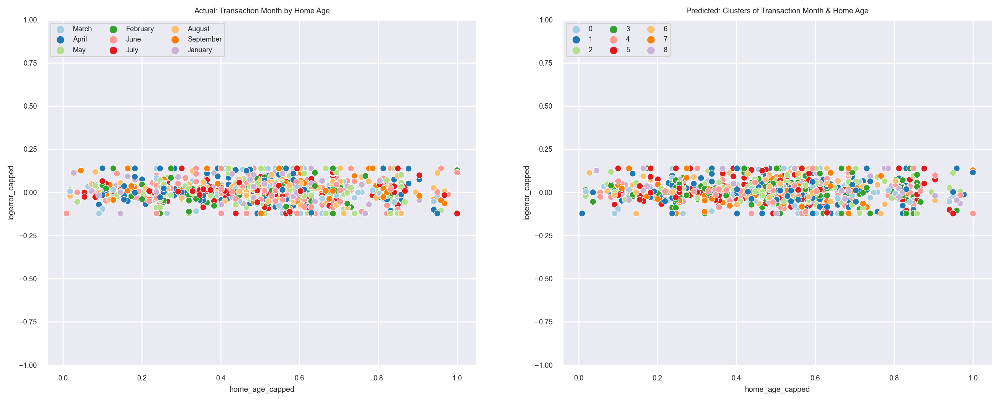

In [269]:
# seeing how clusters compare against actual month & home age plots

plt.subplots(1, 2, figsize = (16, 6), sharex = True, sharey = False)

plt.subplot(121)
sns.scatterplot(
        x = "home_age_capped",
        y = "logerror_capped",
        data = train_imputed.sample(1000, random_state = 14), 
        hue = "transaction_month",
        # hue_order = [
        # 'January',
        # 'August',
        # 'April',
        # 'June',
        # 'May',
        # 'July',
        # 'March',
        # 'February',
        # 'September'],
        palette = ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6']
)

plt.title("Actual: Transaction Month by Home Age")
plt.legend(loc = 'upper left', ncol = 3)
plt.ylim(-1, 1)

plt.subplot(122)
sns.scatterplot(
        x = "home_age_capped",
        y = "logerror_capped",
        data = train_imputed.sample(1000, random_state = 14), 
        hue = "month_clusters",
        # hue_order = [0, 1, 2, 3, 4, 5, 6, 7, 8],
        palette = ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6']
)

plt.title("Predicted: Clusters of Transaction Month & Home Age")
plt.legend(loc = 'upper left', ncol = 3)
plt.ylim(-1, 1)
plt.show()

----
### <u>``2nd Cluster: Build Era and Living Sq. Feet``</u>

In [270]:
# checking the df head

train_dummy.columns.tolist()

['parcel_id',
 'home_value_capped',
 'logerror_capped',
 'living_sq_feet_capped',
 'latitude',
 'longitude',
 'property_sq_feet_capped',
 'county_zoning_code',
 'blockgroup_assignment',
 'year_built_capped',
 'home_age_capped',
 'transaction_month_April',
 'transaction_month_August',
 'transaction_month_February',
 'transaction_month_January',
 'transaction_month_July',
 'transaction_month_June',
 'transaction_month_March',
 'transaction_month_May',
 'transaction_month_September',
 'home_age_binned_new_century',
 'home_age_binned_late_20th_century',
 'home_age_binned_mid_20th_century',
 'home_age_binned_early_20th_century',
 'bathroom_count_capped_0.5',
 'bathroom_count_capped_1.0',
 'bathroom_count_capped_1.5',
 'bathroom_count_capped_2.0',
 'bathroom_count_capped_2.5',
 'bathroom_count_capped_3.0',
 'bathroom_count_capped_3.5',
 'bathroom_count_capped_4.0',
 'bathroom_count_capped_4.5',
 'bedroom_count_capped_1.5',
 'bedroom_count_capped_2.0',
 'bedroom_count_capped_3.0',
 'bedroom_c

In [274]:
# generating second (2) cluster: build era and living sq feet

X_era = train_dummy[[
    'living_sq_feet_capped',
    'home_age_binned_new_century',
    'home_age_binned_late_20th_century',
    'home_age_binned_mid_20th_century',
    'home_age_binned_early_20th_century']]

val_era = validate_dummy[[
    'living_sq_feet_capped',
    'home_age_binned_new_century',
    'home_age_binned_late_20th_century',
    'home_age_binned_mid_20th_century',
    'home_age_binned_early_20th_century']]

test_era = test_dummy[[
    'living_sq_feet_capped',
    'home_age_binned_new_century',
    'home_age_binned_late_20th_century',
    'home_age_binned_mid_20th_century',
    'home_age_binned_early_20th_century']]


X_era.head()

,living_sq_feet_capped,home_age_binned_new_century,home_age_binned_late_20th_century,home_age_binned_mid_20th_century,home_age_binned_early_20th_century
7961,0.48,False,False,True,False
47936,0.53,False,False,False,True
20730,0.62,False,True,False,False
1988,0.27,False,False,True,False
45959,0.48,False,False,True,False


In [275]:
# creating the KMeans cluster object

kmeans = KMeans(n_clusters = 4)
kmeans.fit(X_era)

clusters = kmeans.predict(X_era)
clusters

array([1, 3, 0, ..., 2, 2, 3], dtype=int32)

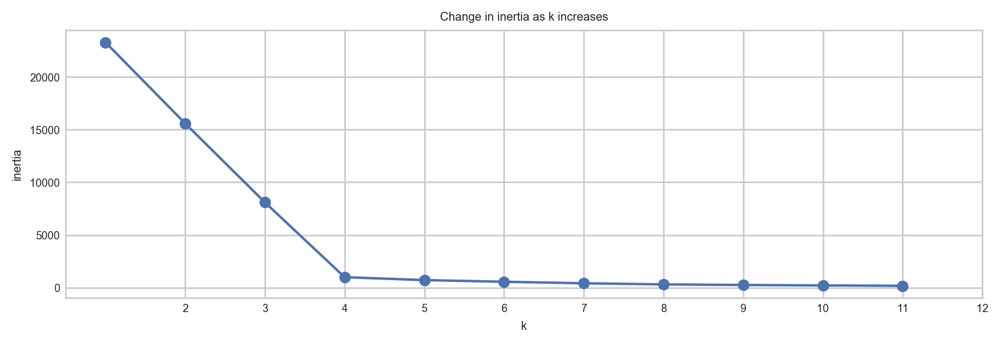

In [276]:
with plt.style.context('seaborn-whitegrid'):

    plt.figure(figsize=(10, 3))
    pd.Series({k: KMeans(k).fit(X_era).inertia_ for k in range(1, 12)}).plot(marker = 'o')
    plt.xticks(range(2, 13))
    
    plt.xlabel('k')
    plt.ylabel('inertia')
    plt.title('Change in inertia as k increases')

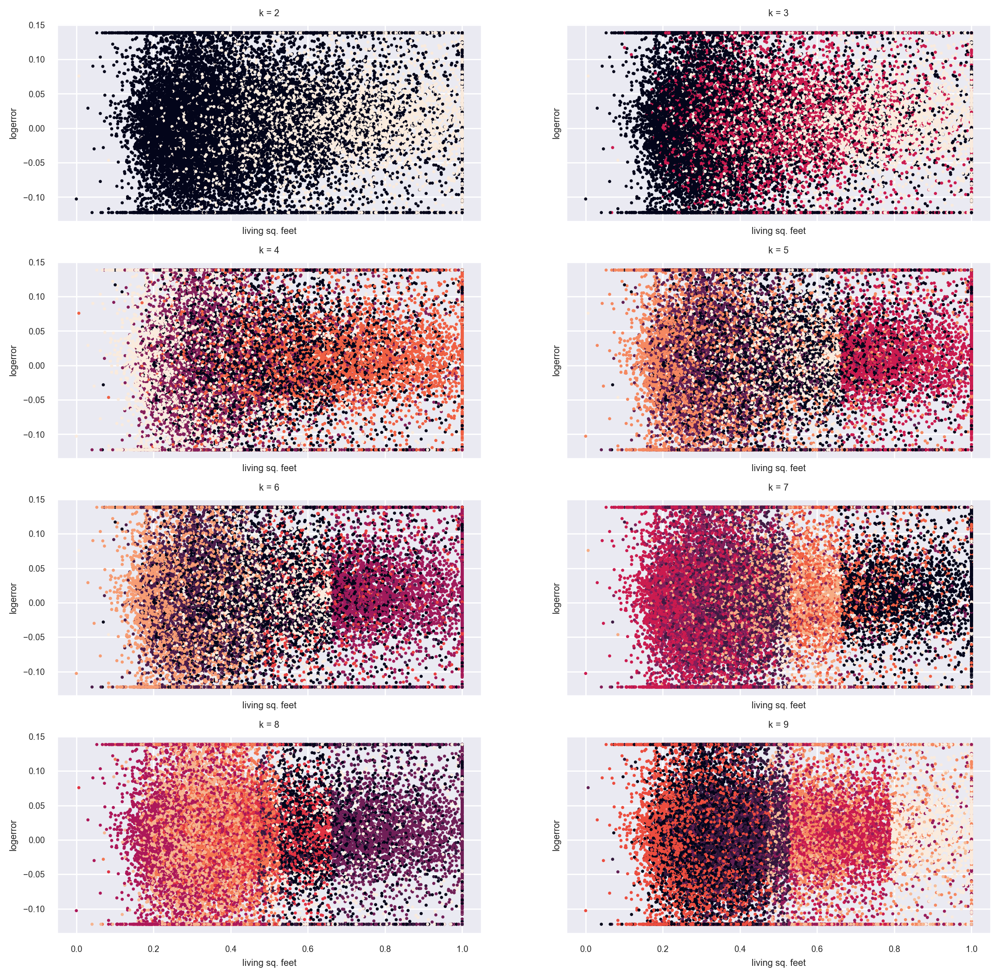

In [277]:
# plotting inertia for number of KMeans clusters

fig, axs = plt.subplots(4, 2, figsize=(13, 13), sharex=True, sharey=True)

for ax, k in zip(axs.ravel(), range(2, 10)):
    # creating and fitting KMeans
    clusters = KMeans(k).fit(X_era).predict(X_era)

    X_era["logerror_capped"] = train_dummy["logerror_capped"]

    ax.scatter(
        X_era["living_sq_feet_capped"], 
        X_era["logerror_capped"], 
        c = clusters,
        s = 2)

    ax.set(title='k = {}'.format(k), xlabel = 'living sq. feet', ylabel = 'logerror')

In [278]:
# cleaning target in KMeans cluster 

X_era = X_era.drop(columns = "logerror_capped")

kmeans = KMeans(n_clusters = 4)
kmeans.fit(X_era)

train_era_clusters = kmeans.predict(X_era)
validate_era_clusters = kmeans.predict(val_era)
test_era_clusters = kmeans.predict(test_era)

train_clusters

array([7, 0, 5, ..., 5, 8, 3], dtype=int32)

In [279]:
# checking the df head
X_era.head()

,living_sq_feet_capped,home_age_binned_new_century,home_age_binned_late_20th_century,home_age_binned_mid_20th_century,home_age_binned_early_20th_century
7961,0.48,False,False,True,False
47936,0.53,False,False,False,True
20730,0.62,False,True,False,False
1988,0.27,False,False,True,False
45959,0.48,False,False,True,False


In [280]:
# adding clusters to original datasets

train_imputed["era_clusters"] = train_era_clusters
validate_imputed["era_clusters"] = validate_era_clusters
test_imputed["era_clusters"] = test_era_clusters

train_imputed.head()

,parcel_id,home_value_capped,logerror_capped,bathroom_count_capped,bedroom_count_capped,living_sq_feet_capped,county_by_fips,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,home_age_capped,transaction_month,home_age_binned,living_sqfeet_binned,transaction_quarter,month_clusters,era_clusters
7961,12167890,0.73,0.14,3.00,3.00,0.48,LA County,0.59,0.70,0.77,0100,0.00,0.46,0.54,February,mid_20th_century,1654_to_2299_sqfeet,q1_transaction,7,3
47936,10933324,1.00,0.01,3.00,4.00,0.53,LA County,0.55,0.59,0.60,0100,0.00,0.26,0.74,August,early_20th_century,1654_to_2299_sqfeet,q3_transaction,2,0
20730,10917682,0.68,-0.04,4.00,4.00,0.62,LA County,0.54,0.56,0.69,0100,0.00,0.51,0.49,April,late_20th_century,2299_to_3863_sqfeet,q2_transaction,5,2
1988,11437314,0.41,-0.05,1.00,3.00,0.27,LA County,0.38,0.59,0.35,0101,0.01,0.42,0.58,January,mid_20th_century,128_to_1267_sqfeet,q1_transaction,6,3
45959,12738926,0.27,0.03,2.00,3.00,0.48,LA County,0.39,0.76,0.56,0100,0.01,0.47,0.53,August,mid_20th_century,1654_to_2299_sqfeet,q3_transaction,2,3


In [281]:
# mean log error per home era

pd.DataFrame(train_imputed.groupby("home_age_binned")["logerror_capped"].mean()).sort_index()

,logerror_capped
home_age_binned,
new_century,0.01
late_20th_century,0.01
mid_20th_century,0.01
early_20th_century,0.01


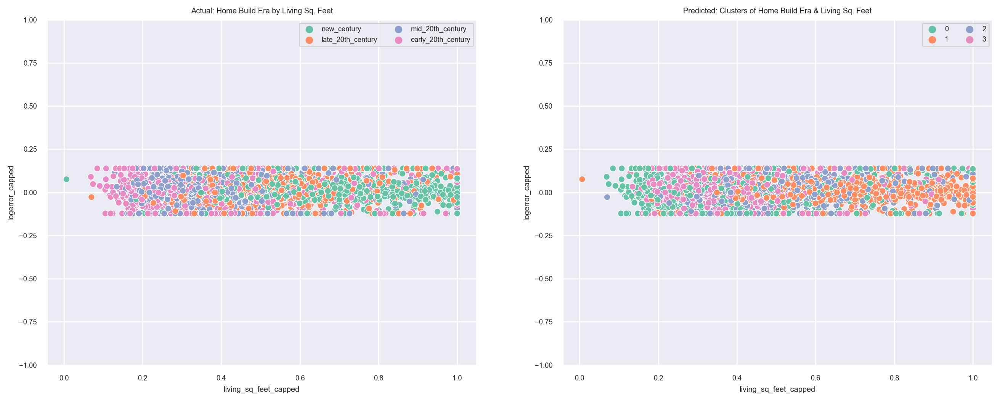

In [282]:
# seeing how clusters compare against actual month & home age plots

plt.subplots(1, 2, figsize = (16, 6), sharex = True, sharey = False)

plt.subplot(121)
sns.scatterplot(
        x = "living_sq_feet_capped",
        y = "logerror_capped",
        data = train_imputed.sample(5000, random_state = 14),
        hue = "home_age_binned",
        # hue_order = ["early_20th_century", "late_20th_century", "mid_20th_century", "new_century"],
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3']
)


plt.title("Actual: Home Build Era by Living Sq. Feet")
plt.legend(loc = 'upper right', ncol = 2)
plt.ylim(-1, 1)

plt.subplot(122)
sns.scatterplot(
        x = "living_sq_feet_capped",
        y = "logerror_capped",
        data = train_imputed.sample(5000, random_state = 14), 
        hue = "era_clusters",
        # hue_order = [0, 1, 2, 3],
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3']
)

# 0 = early 20th
# 1 = new century
# 2 = mid century
# 3 = late 19th

plt.title("Predicted: Clusters of Home Build Era & Living Sq. Feet")
plt.legend(loc = 'upper right', ncol = 2)
plt.ylim(-1, 1)
plt.show()

----
### <u>``3rd Cluster: Size of Homes Binned and Home Age``</u>

In [283]:
# checking the df columns

train_dummy.columns.tolist()

['parcel_id',
 'home_value_capped',
 'logerror_capped',
 'living_sq_feet_capped',
 'latitude',
 'longitude',
 'property_sq_feet_capped',
 'county_zoning_code',
 'blockgroup_assignment',
 'year_built_capped',
 'home_age_capped',
 'transaction_month_April',
 'transaction_month_August',
 'transaction_month_February',
 'transaction_month_January',
 'transaction_month_July',
 'transaction_month_June',
 'transaction_month_March',
 'transaction_month_May',
 'transaction_month_September',
 'home_age_binned_new_century',
 'home_age_binned_late_20th_century',
 'home_age_binned_mid_20th_century',
 'home_age_binned_early_20th_century',
 'bathroom_count_capped_0.5',
 'bathroom_count_capped_1.0',
 'bathroom_count_capped_1.5',
 'bathroom_count_capped_2.0',
 'bathroom_count_capped_2.5',
 'bathroom_count_capped_3.0',
 'bathroom_count_capped_3.5',
 'bathroom_count_capped_4.0',
 'bathroom_count_capped_4.5',
 'bedroom_count_capped_1.5',
 'bedroom_count_capped_2.0',
 'bedroom_count_capped_3.0',
 'bedroom_c

In [284]:
# seeting X features for home size cluster

X_home_size = train_dummy[[ 
    'home_age_capped',
    'living_sqfeet_binned_128_to_1267_sqfeet',
    'living_sqfeet_binned_1267_to_1654_sqfeet',
    'living_sqfeet_binned_1654_to_2299_sqfeet',
    'living_sqfeet_binned_2299_to_3863_sqfeet'
]]

val_home_size = validate_dummy[[ 
    'home_age_capped',
    'living_sqfeet_binned_128_to_1267_sqfeet',
    'living_sqfeet_binned_1267_to_1654_sqfeet',
    'living_sqfeet_binned_1654_to_2299_sqfeet',
    'living_sqfeet_binned_2299_to_3863_sqfeet'
]]

test_home_size = test_dummy[[ 
    'home_age_capped',
    'living_sqfeet_binned_128_to_1267_sqfeet',
    'living_sqfeet_binned_1267_to_1654_sqfeet',
    'living_sqfeet_binned_1654_to_2299_sqfeet',
    'living_sqfeet_binned_2299_to_3863_sqfeet'
]]

X_home_size.head()

,home_age_capped,living_sqfeet_binned_128_to_1267_sqfeet,living_sqfeet_binned_1267_to_1654_sqfeet,living_sqfeet_binned_1654_to_2299_sqfeet,living_sqfeet_binned_2299_to_3863_sqfeet
7961,0.54,False,False,True,False
47936,0.74,False,False,True,False
20730,0.49,False,False,False,True
1988,0.58,True,False,False,False
45959,0.53,False,False,True,False


In [285]:
# creating the KMeans cluster object

kmeans = KMeans(n_clusters = 4)
kmeans.fit(X_home_size)

clusters = kmeans.predict(X_home_size)
clusters

array([0, 0, 1, ..., 1, 0, 2], dtype=int32)

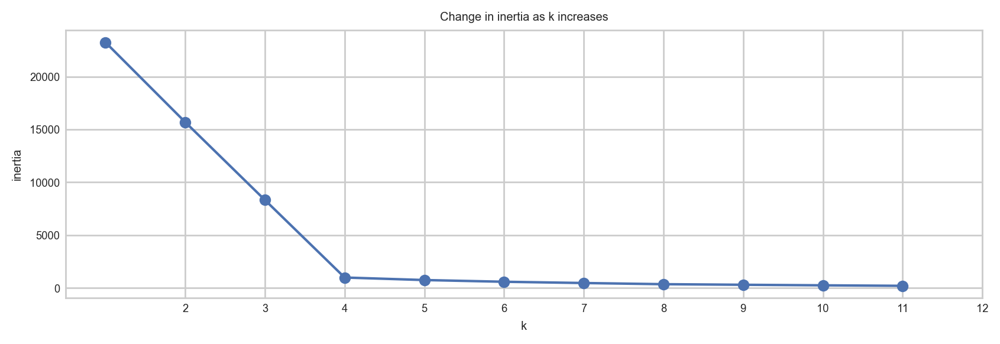

In [286]:
with plt.style.context('seaborn-whitegrid'):

    plt.figure(figsize=(10, 3))
    pd.Series({k: KMeans(k).fit(X_home_size).inertia_ for k in range(1, 12)}).plot(marker = 'o')
    plt.xticks(range(2, 13))
    
    plt.xlabel('k')
    plt.ylabel('inertia')
    plt.title('Change in inertia as k increases')

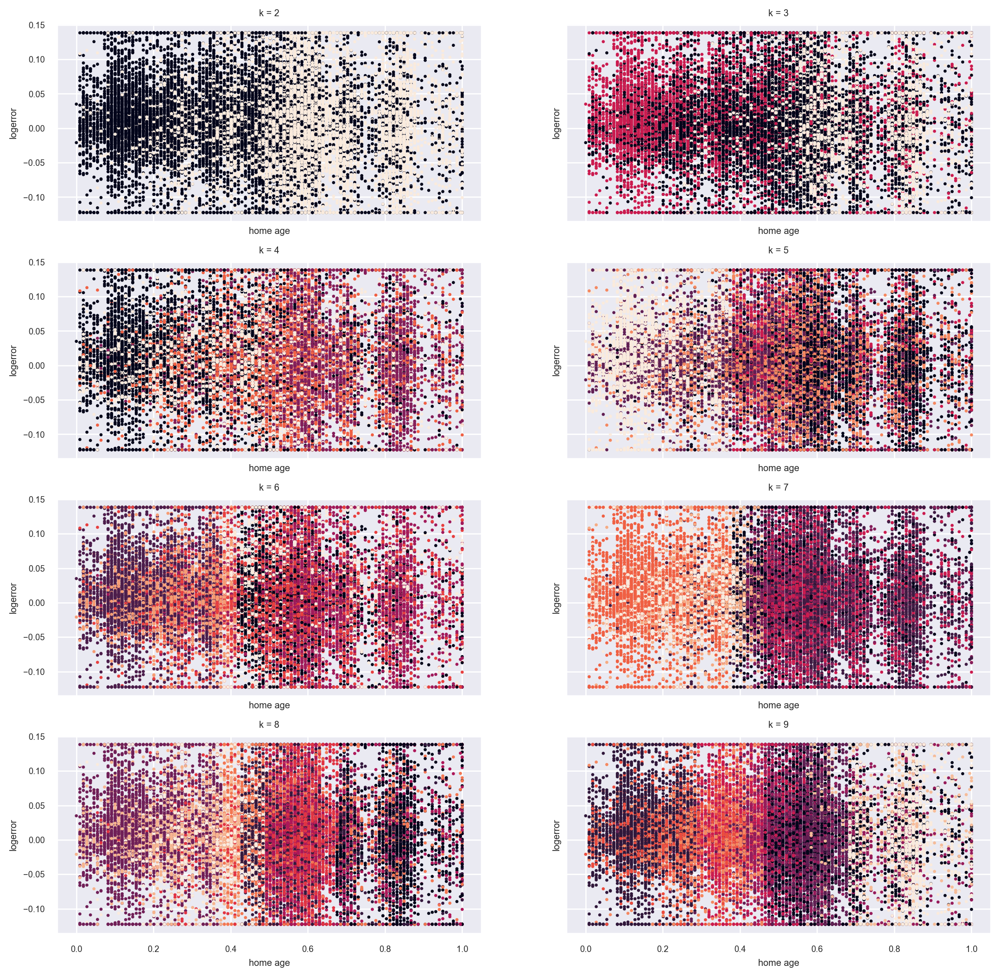

In [287]:
# plotting inertia for number of KMeans clusters

fig, axs = plt.subplots(4, 2, figsize=(13, 13), sharex=True, sharey=True)

for ax, k in zip(axs.ravel(), range(2, 10)):
    # creating and fitting KMeans
    clusters = KMeans(k).fit(X_home_size).predict(X_home_size)

    X_home_size["logerror_capped"] = train_dummy["logerror_capped"]

    ax.scatter(
        X_home_size["home_age_capped"], 
        X_home_size["logerror_capped"], 
        c = clusters,
        s = 2)

    ax.set(title='k = {}'.format(k), xlabel = 'home age', ylabel = 'logerror')

In [288]:
# cleaning target in KMeans cluster 

X_home_size = X_home_size.drop(columns = "logerror_capped")

kmeans = KMeans(n_clusters = 4)
kmeans.fit(X_home_size)

train_size_clusters = kmeans.predict(X_home_size)
val_size_clusters = kmeans.predict(val_home_size)
test_size_clusters = kmeans.predict(test_home_size)

train_size_clusters

array([1, 1, 3, ..., 3, 1, 2], dtype=int32)

In [289]:
# checking df head

X_home_size.head() # checks out!

,home_age_capped,living_sqfeet_binned_128_to_1267_sqfeet,living_sqfeet_binned_1267_to_1654_sqfeet,living_sqfeet_binned_1654_to_2299_sqfeet,living_sqfeet_binned_2299_to_3863_sqfeet
7961,0.54,False,False,True,False
47936,0.74,False,False,True,False
20730,0.49,False,False,False,True
1988,0.58,True,False,False,False
45959,0.53,False,False,True,False


In [290]:
# adding clusters to original datasets

train_imputed["size_clusters"] = train_size_clusters
validate_imputed["size_clusters"] = val_size_clusters
test_imputed["size_clusters"] = test_size_clusters

train_imputed.head()

,parcel_id,home_value_capped,logerror_capped,bathroom_count_capped,bedroom_count_capped,living_sq_feet_capped,county_by_fips,latitude,longitude,property_sq_feet_capped,...,blockgroup_assignment,year_built_capped,home_age_capped,transaction_month,home_age_binned,living_sqfeet_binned,transaction_quarter,month_clusters,era_clusters,size_clusters
7961,12167890,0.73,0.14,3.00,3.00,0.48,LA County,0.59,0.70,0.77,...,0.00,0.46,0.54,February,mid_20th_century,1654_to_2299_sqfeet,q1_transaction,7,3,1
47936,10933324,1.00,0.01,3.00,4.00,0.53,LA County,0.55,0.59,0.60,...,0.00,0.26,0.74,August,early_20th_century,1654_to_2299_sqfeet,q3_transaction,2,0,1
20730,10917682,0.68,-0.04,4.00,4.00,0.62,LA County,0.54,0.56,0.69,...,0.00,0.51,0.49,April,late_20th_century,2299_to_3863_sqfeet,q2_transaction,5,2,3
1988,11437314,0.41,-0.05,1.00,3.00,0.27,LA County,0.38,0.59,0.35,...,0.01,0.42,0.58,January,mid_20th_century,128_to_1267_sqfeet,q1_transaction,6,3,2
45959,12738926,0.27,0.03,2.00,3.00,0.48,LA County,0.39,0.76,0.56,...,0.01,0.47,0.53,August,mid_20th_century,1654_to_2299_sqfeet,q3_transaction,2,3,1


In [291]:
# log error mean by home size bins

pd.DataFrame(train_imputed.groupby("living_sqfeet_binned")["logerror_capped"].mean()).sort_index()

,logerror_capped
living_sqfeet_binned,
128_to_1267_sqfeet,0.01
1267_to_1654_sqfeet,0.01
1654_to_2299_sqfeet,0.01
2299_to_3863_sqfeet,0.02


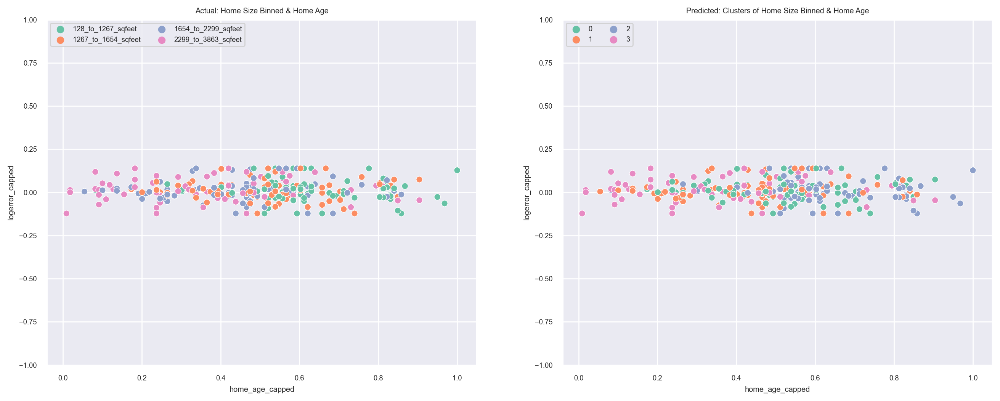

In [292]:
# seeing how clusters compare against actual month & home age plots

plt.subplots(1, 2, figsize = (16, 6), sharex = True, sharey = False)

plt.subplot(121)
sns.scatterplot(
        x = "home_age_capped",
        y = "logerror_capped",
        data = train_imputed.sample(300, random_state = 14),
        hue = "living_sqfeet_binned",
        # hue_order = ['128_to_1267_sqfeet', '1267_to_1654_sqfeet', '1654_to_2299_sqfeet', '2299_to_3863_sqfeet'],
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3'],
)

plt.title("Actual: Home Size Binned & Home Age")
plt.legend(loc = 'upper left', ncol = 2)
plt.ylim(-1, 1)

plt.subplot(122)
sns.scatterplot(
        x = "home_age_capped",
        y = "logerror_capped",
        data = train_imputed.sample(300, random_state = 14), 
        hue = "size_clusters",
        # hue_order = [0, 1, 2, 3],
        palette = ['#66c2a5','#fc8d62','#8da0cb','#e78ac3']
)

plt.title("Predicted: Clusters of Home Size Binned & Home Age")
plt.legend(loc = 'upper left', ncol = 2)
plt.ylim(-1, 1)
plt.show()

---- 
### ``Cluster Exploration``

In [293]:
# let's check the df head

train_imputed.columns.tolist()

['parcel_id',
 'home_value_capped',
 'logerror_capped',
 'bathroom_count_capped',
 'bedroom_count_capped',
 'living_sq_feet_capped',
 'county_by_fips',
 'latitude',
 'longitude',
 'property_sq_feet_capped',
 'county_zoning_code',
 'blockgroup_assignment',
 'year_built_capped',
 'home_age_capped',
 'transaction_month',
 'home_age_binned',
 'living_sqfeet_binned',
 'transaction_quarter',
 'month_clusters',
 'era_clusters',
 'size_clusters']

In [294]:
# checking the df shape

train_imputed.shape

(29253, 21)

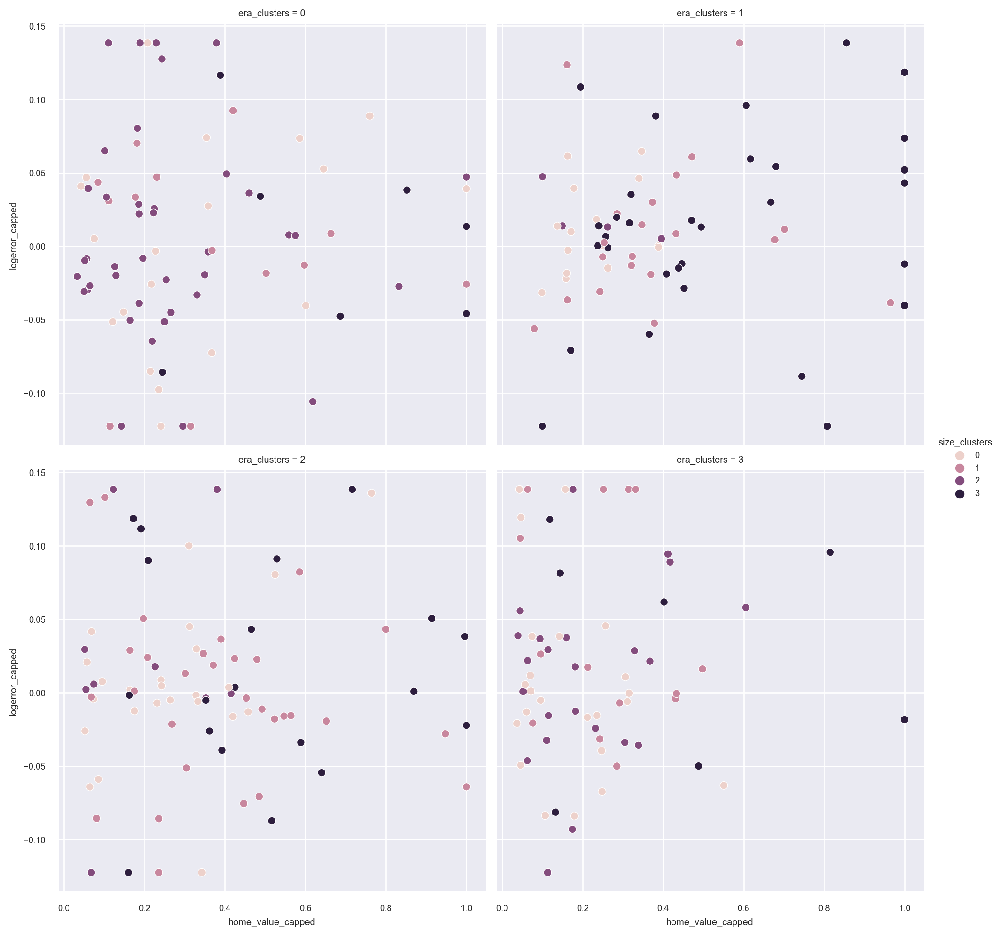

In [295]:
# plotting clusters
# era cluster first

sns.relplot(data = train_imputed.sample(300, random_state = 14), x = "home_value_capped", y = "logerror_capped", col = "era_clusters", hue = "size_clusters", col_wrap = 2)
plt.show()

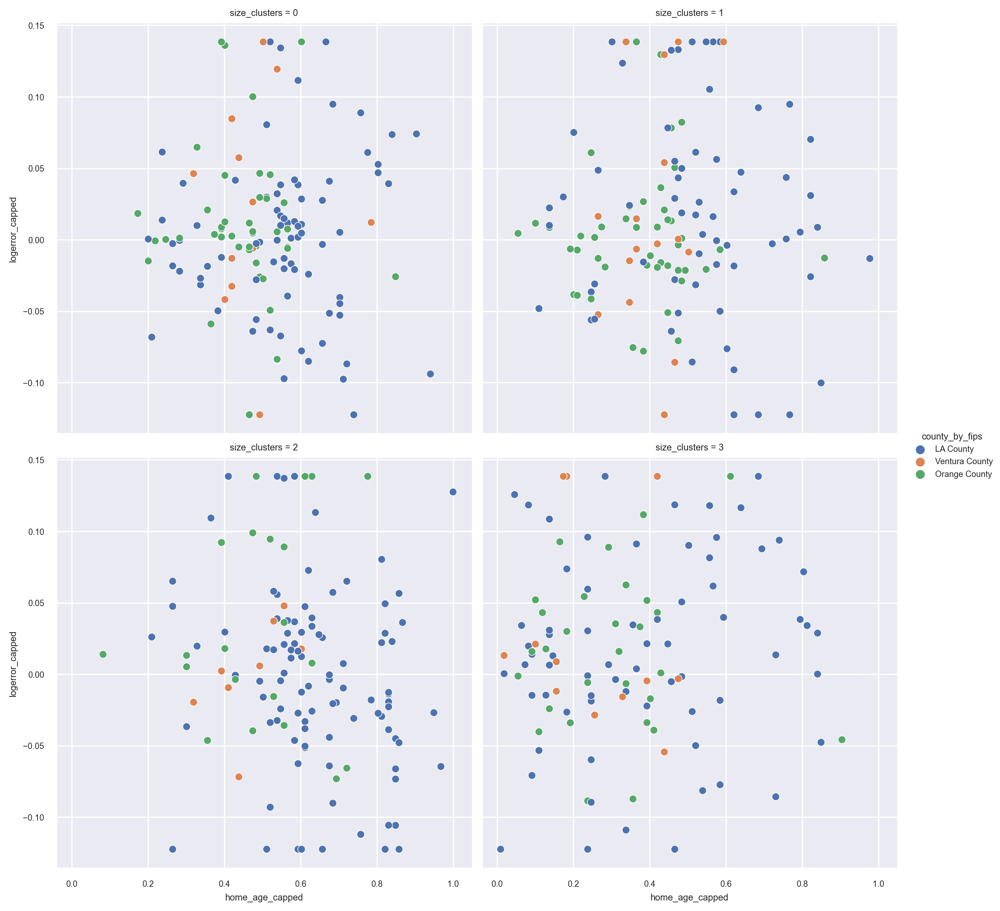

In [296]:
# plotting clusters
# month clusters

sns.relplot(data = train_imputed.sample(500, random_state = 14), x = "home_age_capped", y = "logerror_capped", col = "size_clusters", hue = "county_by_fips", col_wrap = 2)
plt.show()

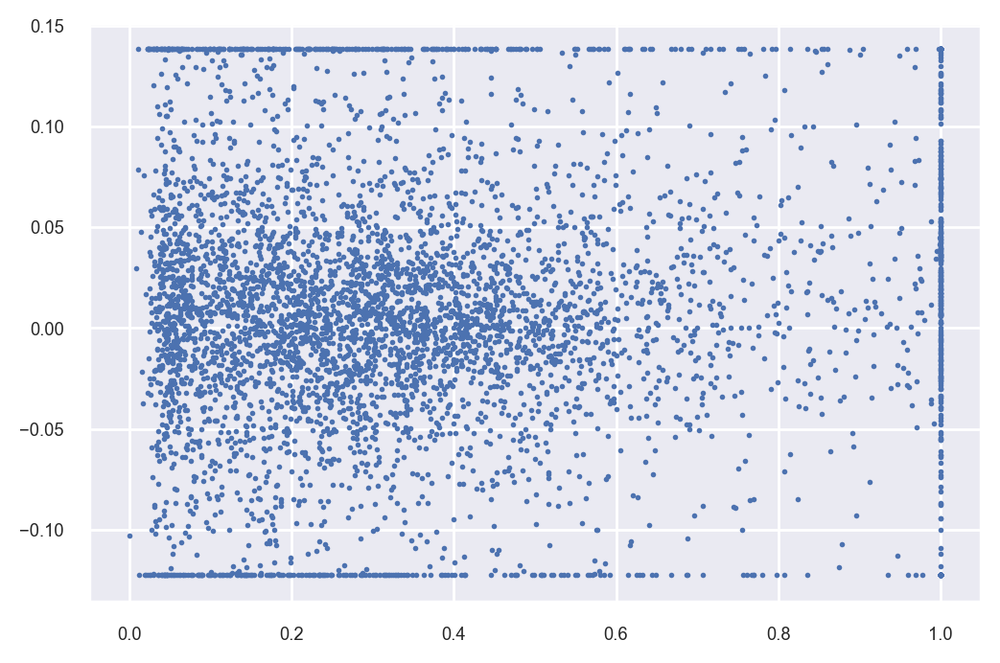

In [298]:
plt.scatter(x = "home_value_capped", y = "logerror_capped", data = train_imputed.sample(5000, random_state = 14), s = 1)
plt.show()

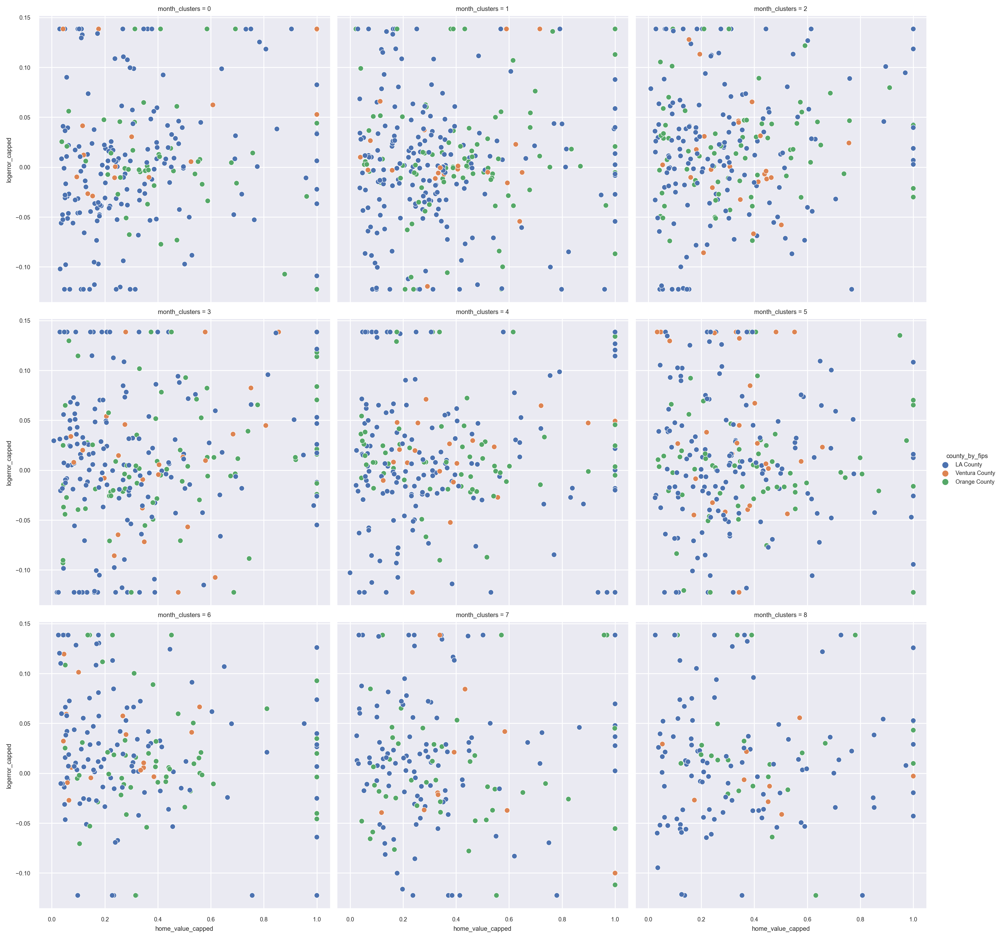

In [300]:
# plotting clusters
# month clusters

sns.relplot(data = train_imputed.sample(2000, random_state = 14), x = "home_value_capped", y = "logerror_capped", col = "month_clusters", hue = "county_by_fips", col_wrap = 3)
plt.show()

In [301]:
# creating dummy dataframes with generated clusters

# train dataset
train_dummy = pd.get_dummies(data = train_imputed, columns = [
    'transaction_month',
    'county_by_fips',
    'home_age_binned',
    'living_sqfeet_binned',
    'bathroom_count_capped',
    'bedroom_count_capped',
    'month_clusters',
    'era_clusters',
    'size_clusters'],
    drop_first = False, 
    dtype = bool)

# validate dataset
validate_dummy = pd.get_dummies(data = validate_imputed, columns = [
    'transaction_month',
    'county_by_fips',
    'home_age_binned',
    'living_sqfeet_binned',
    'bathroom_count_capped',
    'bedroom_count_capped',
    'month_clusters',
    'era_clusters',
    'size_clusters'],
    drop_first = False, 
    dtype = bool)

# test dataset
test_dummy = pd.get_dummies(data = test_imputed, columns = [
    'transaction_month',
    'county_by_fips',
    'home_age_binned',
    'living_sqfeet_binned',
    'bathroom_count_capped',
    'bedroom_count_capped',
    'month_clusters',
    'era_clusters',
    'size_clusters'],
    drop_first = False, 
    dtype = bool)

In [302]:
# checking the dataframe

train_dummy.head()

,parcel_id,home_value_capped,logerror_capped,living_sq_feet_capped,latitude,longitude,property_sq_feet_capped,county_zoning_code,blockgroup_assignment,year_built_capped,...,month_clusters_7,month_clusters_8,era_clusters_0,era_clusters_1,era_clusters_2,era_clusters_3,size_clusters_0,size_clusters_1,size_clusters_2,size_clusters_3
7961,12167890,0.73,0.14,0.48,0.59,0.70,0.77,0100,0.00,0.46,...,True,False,False,False,False,True,False,True,False,False
47936,10933324,1.00,0.01,0.53,0.55,0.59,0.60,0100,0.00,0.26,...,False,False,True,False,False,False,False,True,False,False
20730,10917682,0.68,-0.04,0.62,0.54,0.56,0.69,0100,0.00,0.51,...,False,False,False,False,True,False,False,False,False,True
1988,11437314,0.41,-0.05,0.27,0.38,0.59,0.35,0101,0.01,0.42,...,False,False,False,False,False,True,False,False,True,False
45959,12738926,0.27,0.03,0.48,0.39,0.76,0.56,0100,0.01,0.47,...,False,False,False,False,False,True,False,True,False,False


In [303]:
# checking the shape

train_dummy.shape

(29253, 64)

In [304]:
# establishing logerror baseline
def establish_baseline(train, validate):

    baseline = round(train["logerror_capped"].mean(), 2)

    train['baseline'] = baseline
    validate['baseline'] = baseline

    train_rmse = sqrt(mean_squared_error(train.logerror_capped, train.baseline))
    validate_rmse = sqrt(mean_squared_error(validate.logerror_capped, validate.baseline))

    print('Train baseline RMSE: {:.2f}'.format(train_rmse))
    print('Validate baseline RMSE: {:.2f}'.format(validate_rmse))

    train = train.drop(columns = "baseline")
    validate = validate.drop(columns = "baseline")
    print()
    print(f'train shape: {train.shape}')
    print(f'validate shape: {validate.shape}')

    return train, validate

In [305]:
# establishing dataset baselines for train and validate df

train_dummy, validate_dummy = establish_baseline(train_dummy, validate_dummy)

Train baseline RMSE: 0.06
Validate baseline RMSE: 0.06

train shape: (29253, 64)
validate shape: (12537, 64)


In [306]:
# let's first resplit the data to visualize clusters against other features
# 2nd split: splitting larger datasets into x and y variables

X_train = train_dummy.drop(columns = [
    "logerror_capped", 
    "home_value_capped",
    'blockgroup_assignment',
    'parcel_id',
    'transaction_quarter',
    'county_zoning_code'])

y_train = train_dummy["logerror_capped"]

X_validate = validate_dummy.drop(columns = [
    "logerror_capped", 
    "home_value_capped",
    'blockgroup_assignment',
    'parcel_id',
    'transaction_quarter',
    'county_zoning_code'])

y_validate = validate_dummy["logerror_capped"]

X_test = test_dummy.drop(columns = [
    "logerror_capped", 
    "home_value_capped",
    'blockgroup_assignment',
    'parcel_id',
    'transaction_quarter',
    'county_zoning_code'])
    
y_test = test_dummy["logerror_capped"]

In [307]:
# checking the shape

print(X_train.shape)
print(y_train.shape)

(29253, 58)
(29253,)


In [308]:
X_train.dtypes

living_sq_feet_capped                       float64
latitude                                    float64
longitude                                   float64
property_sq_feet_capped                     float64
year_built_capped                           float64
home_age_capped                             float64
transaction_month_April                        bool
transaction_month_August                       bool
transaction_month_February                     bool
transaction_month_January                      bool
transaction_month_July                         bool
transaction_month_June                         bool
transaction_month_March                        bool
transaction_month_May                          bool
transaction_month_September                    bool
county_by_fips_LA County                       bool
county_by_fips_Orange County                   bool
county_by_fips_Ventura County                  bool
home_age_binned_new_century                    bool
home_age_bin

In [ ]:
# converting category columns to object type

# X_train[["home_age_binned", "living_sqfeet_binned"]] = X_train[["home_age_binned", "living_sqfeet_binned"]].astype(object)

In [ ]:
# creating a recursive feature eliminate function

def recursive_feature_eliminate(X_train, y_train, number_of_top_features):

    # initialize the ML algorithm
    lm = LinearRegression()

    rfe = RFE(lm, n_features_to_select = number_of_top_features)

    # fit the data using RFE
    rfe.fit(X_train, y_train) 

    # get the mask of the columns selected
    feature_mask = rfe.support_

    # get list of the column names
    rfe_features = X_train.iloc[:,feature_mask].columns.tolist()

    # view list of columns and their ranking
    # get the ranks using "rfe.ranking" method
    variable_ranks = rfe.ranking_

    # get the variable names
    variable_names = X_train.columns.tolist()

    # combine ranks and names into a df for clean viewing
    rfe_ranks_df = pd.DataFrame({'Feature': variable_names, 'Ranking': variable_ranks})

    # sort the df by rank
    return rfe_ranks_df.sort_values('Ranking')

In [ ]:
# removing duplicate cluster columns (home_era, home_size, transaction_months)

X_train = X_train.drop(columns = [
'home_age_binned_new_century',         
'home_age_binned_mid 20th_century',        
'home_age_binned_early 20th_century',     
'home_age_binned_late 19th century',      
'living_sqfeet_binned_128_to_1267_sqfeet', 
'living_sqfeet_binned_1267_to_1654_sqfeet',
'living_sqfeet_binned_1654_to_2299_sqfeet',
'living_sqfeet_binned_2299_to_3863_sqfeet',
'transaction_month_April',                      
'transaction_month_August',                      
'transaction_month_February',                    
'transaction_month_January',                     
'transaction_month_July',                       
'transaction_month_June',                        
'transaction_month_March',                       
'transaction_month_May',                         
'transaction_month_September'
])

In [ ]:
# using the recursive feature elimination function

recursive_feature_eliminate(X_train, y_train, 10)

,Feature,Ranking
19,bedroom_count_capped_4.0,1
36,size_clusters_1,1
35,size_clusters_0,1
21,bedroom_count_capped_5.5,1
20,bedroom_count_capped_5.0,1
37,size_clusters_2,1
18,bedroom_count_capped_3.0,1
17,bedroom_count_capped_2.0,1
38,size_clusters_3,1
8,county_by_fips_Ventura County,1
